In [1]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from sklearn.linear_model import Ridge
plt.style.use('dark_background')

In [2]:
import numpy as np
import pandas as pd
import seaborn as sns

In [3]:
df=pd.read_csv("Auto.csv")
df

,mpg,cylinders,displacement,horsepower,weight,acceleration,year,origin,name
0,18.0,8,307.0,130,3504,12.0,70,1,chevrolet chevelle malibu
1,15.0,8,350.0,165,3693,11.5,70,1,buick skylark 320
2,18.0,8,318.0,150,3436,11.0,70,1,plymouth satellite
3,16.0,8,304.0,150,3433,12.0,70,1,amc rebel sst
4,17.0,8,302.0,140,3449,10.5,70,1,ford torino
...,...,...,...,...,...,...,...,...,...
392,27.0,4,140.0,86,2790,15.6,82,1,ford mustang gl
393,44.0,4,97.0,52,2130,24.6,82,2,vw pickup
394,32.0,4,135.0,84,2295,11.6,82,1,dodge rampage
395,28.0,4,120.0,79,2625,18.6,82,1,ford ranger


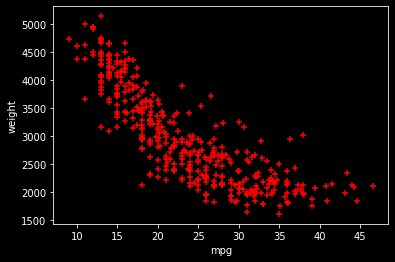

In [4]:
plt.xlabel('mpg')
plt.ylabel('weight')
plt.scatter(df.mpg,df.weight,color='red',marker='+')

Assigning 'x' and 'y' values

In [5]:
x = np.array(df["mpg"])
y = np.array(df["weight"])
d=15

Creating training, cross-validating, and test sets
Out of the 397 data set, allocate 238 to trg, 80 to CV, and 79 to test set, respectively.

In [6]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.4)
x_test,x_cv,y_test,y_cv=train_test_split(x_test,y_test,test_size=0.5)

Computing my hypothesis

In [7]:
def coeff(d):
    coeff=[]
    for i in range(d):
        i=i+1
        a1=np.polyfit(x_train,y_train,i)
        coeff.append(a1)
    return coeff
A=coeff(d)

In [8]:
def hypo(d):
    U=[1]
    for i in range(d):
        i=i+1
        a1=(x_cv)**i
        U.insert(0,a1)
    return U

Computing the cost fcn of each polynomial degree with x_cv set

In [9]:
def CostVector(d):
    W=[]
    for i in range(d):
        i=i+1
        cost=sum((sum(A[i-1]*hypo(i))-y_cv)**2)/(2*len(y_cv))
        W.append(cost)
    return W
W=np.array(CostVector(d))

Finding the degree of polynomial that results in smallest J_cv

In [10]:
mincost = np.amin(W)
result = np.where(W == np.amin(W))
print("polynomial degree that minimizes J_cv: {},   J_cv value: {}".format(np.where(W==np.amin(W))+np.array([1]),mincost))

polynomial degree that minimizes J_cv: [[3]],   J_cv value: 64233.74472301981


Optimal degree, for the sake of exercise, is 6. Next step is to implement regularization

In [17]:
X=x_train
Y=y_train
lamb=200
def gradient_descent(X,Y):
    weight_0=0
    weight_1=0
    iterations=150000
    n=len(Y)
    learning_rate=0.001
    for i in range(iterations):
        gd_y=weight_1*X+weight_0
        weight_1_der=-(1/n)*sum(X*(Y-gd_y))+(lamb/len(y_train))*weight_1
        weight_0_der=-(1/n)*sum(Y-gd_y)+(lamb/len(y_train))*weight_0
        temp1=weight_1-learning_rate*weight_1_der
        temp0=weight_0-learning_rate*weight_0_der
        weight_1=temp1
        weight_0=temp0
        print("slope {},   y-intercept {},   iteration {}".format(weight_1,weight_0,i))
        
gradient_descent(X,Y)


slope 63.799922268907565,   y-intercept 2.9574915966386555,   iteration 0
slope 89.28528647958461,   y-intercept 4.423645586319823,   iteration 1
slope 99.45897698361665,   y-intercept 5.293549368995682,   iteration 2
slope 103.5136587793491,   y-intercept 5.924907839399852,   iteration 3
slope 105.12300549601584,   y-intercept 6.460671199704099,   iteration 4
slope 105.75513088337593,   y-intercept 6.957967025544914,   iteration 5
slope 105.99673865508211,   y-intercept 7.439625512756084,   iteration 6
slope 106.0822937762649,   y-intercept 7.91477056174891,   iteration 7
slope 106.10549569898689,   y-intercept 8.387048612556127,   iteration 8
slope 106.10378961665641,   y-intercept 8.85791714217048,   iteration 9
slope 106.09213977868498,   y-intercept 9.327958849929317,   iteration 10
slope 106.07652635301578,   y-intercept 9.79740684669604,   iteration 11
slope 106.05933919040069,   y-intercept 10.266354536722849,   iteration 12
slope 106.04153333965536,   y-intercept 10.7348394929

slope 93.32021449339595,   y-intercept 337.66788643226676,   iteration 1144
slope 93.31388549538809,   y-intercept 337.8305356625431,   iteration 1145
slope 93.3075624091719,   y-intercept 337.9930329653955,   iteration 1146
slope 93.30124522922527,   y-intercept 338.15537848273635,   iteration 1147
slope 93.2949339500313,   y-intercept 338.31757235634547,   iteration 1148
slope 93.28862856607819,   y-intercept 338.4796147278702,   iteration 1149
slope 93.28232907185932,   y-intercept 338.6415057388258,   iteration 1150
slope 93.2760354618732,   y-intercept 338.803245530595,   iteration 1151
slope 93.26974773062351,   y-intercept 338.96483424442874,   iteration 1152
slope 93.26346587261902,   y-intercept 339.12627202144597,   iteration 1153
slope 93.25718988237365,   y-intercept 339.2875590026337,   iteration 1154
slope 93.25091975440644,   y-intercept 339.44869532884735,   iteration 1155
slope 93.24465548324156,   y-intercept 339.6096811408108,   iteration 1156
slope 93.23839706340827

slope 88.95714042586306,   y-intercept 449.79474092663656,   iteration 2249
slope 88.95488688891037,   y-intercept 449.8526546833323,   iteration 2250
slope 88.9526354569419,   y-intercept 449.91051434393506,   iteration 2251
slope 88.95038612799144,   y-intercept 449.9683199589751,   iteration 2252
slope 88.94813890009459,   y-intercept 450.0260715789352,   iteration 2253
slope 88.9458937712888,   y-intercept 450.0837692542512,   iteration 2254
slope 88.94365073961335,   y-intercept 450.14141303531164,   iteration 2255
slope 88.94140980310935,   y-intercept 450.1990029724581,   iteration 2256
slope 88.93917095981975,   y-intercept 450.2565391159851,   iteration 2257
slope 88.93693420778932,   y-intercept 450.3140215161402,   iteration 2258
slope 88.93469954506465,   y-intercept 450.37145022312404,   iteration 2259
slope 88.93246696969416,   y-intercept 450.4288252870903,   iteration 2260
slope 88.93023647972811,   y-intercept 450.48614675814594,   iteration 2261
slope 88.9280080732185

slope 87.41654189886623,   y-intercept 489.38665804678095,   iteration 3338
slope 87.41572740447877,   y-intercept 489.4075897779998,   iteration 3339
slope 87.41491367089438,   y-intercept 489.42850195730324,   iteration 3340
slope 87.4141006974024,   y-intercept 489.4493946029542,   iteration 3341
slope 87.41328848329287,   y-intercept 489.4702677331988,   iteration 3342
slope 87.41247702785645,   y-intercept 489.4911213662659,   iteration 3343
slope 87.41166633038448,   y-intercept 489.5119555203674,   iteration 3344
slope 87.41085639016895,   y-intercept 489.5327702136983,   iteration 3345
slope 87.41004720650253,   y-intercept 489.55356546443653,   iteration 3346
slope 87.40923877867854,   y-intercept 489.57434129074295,   iteration 3347
slope 87.40843110599097,   y-intercept 489.5950977107616,   iteration 3348
slope 87.40762418773446,   y-intercept 489.6158347426195,   iteration 3349
slope 87.40681802320431,   y-intercept 489.6365524044267,   iteration 3350
slope 87.4060126116964

slope 86.8535997597318,   y-intercept 503.85373569581293,   iteration 4448
slope 86.85331109844476,   y-intercept 503.86115401638875,   iteration 4449
slope 86.85302270679053,   y-intercept 503.86856540765825,   iteration 4450
slope 86.85273458451722,   y-intercept 503.875969876094,   iteration 4451
slope 86.85244673137322,   y-intercept 503.88336742816244,   iteration 4452
slope 86.85215914710714,   y-intercept 503.89075807032407,   iteration 4453
slope 86.85187183146783,   y-intercept 503.89814180903323,   iteration 4454
slope 86.85158478420436,   y-intercept 503.9055186507384,   iteration 4455
slope 86.85129800506606,   y-intercept 503.9128886018818,   iteration 4456
slope 86.85101149380246,   y-intercept 503.9202516688998,   iteration 4457
slope 86.85072525016336,   y-intercept 503.9276078582228,   iteration 4458
slope 86.85043927389877,   y-intercept 503.9349571762751,   iteration 4459
slope 86.85015356475895,   y-intercept 503.942299629475,   iteration 4460
slope 86.8498681224943

slope 86.65226306329468,   y-intercept 509.0278973342257,   iteration 5576
slope 86.65216246662737,   y-intercept 509.0304825729138,   iteration 5577
slope 86.6520619639254,   y-intercept 509.03306539678164,   iteration 5578
slope 86.65196155510102,   y-intercept 509.0356458080849,   iteration 5579
slope 86.65186124006655,   y-intercept 509.03822380907707,   iteration 5580
slope 86.65176101873436,   y-intercept 509.04079940200955,   iteration 5581
slope 86.65166089101692,   y-intercept 509.0433725891317,   iteration 5582
slope 86.6515608568268,   y-intercept 509.0459433726908,   iteration 5583
slope 86.65146091607664,   y-intercept 509.04851175493184,   iteration 5584
slope 86.65136106867915,   y-intercept 509.05107773809794,   iteration 5585
slope 86.65126131454714,   y-intercept 509.05364132443,   iteration 5586
slope 86.65116165359349,   y-intercept 509.0562025161668,   iteration 5587
slope 86.65106208573117,   y-intercept 509.05876131554515,   iteration 5588
slope 86.6509626108732,

slope 86.5823447946052,   y-intercept 510.82473035115333,   iteration 6697
slope 86.58230950720761,   y-intercept 510.8256372037151,   iteration 6698
slope 86.58227425277127,   y-intercept 510.8265432092038,   iteration 6699
slope 86.5822390312654,   y-intercept 510.8274483684108,   iteration 6700
slope 86.58220384265925,   y-intercept 510.8283526821265,   iteration 6701
slope 86.58216868692209,   y-intercept 510.8292561511406,   iteration 6702
slope 86.5821335640232,   y-intercept 510.83015877624223,   iteration 6703
slope 86.58209847393191,   y-intercept 510.83106055821963,   iteration 6704
slope 86.58206341661757,   y-intercept 510.8319614978604,   iteration 6705
slope 86.58202839204958,   y-intercept 510.8328615959513,   iteration 6706
slope 86.58199340019735,   y-intercept 510.83376085327836,   iteration 6707
slope 86.58195844103031,   y-intercept 510.83465927062696,   iteration 6708
slope 86.58192351451794,   y-intercept 510.8355568487817,   iteration 6709
slope 86.58188862062973

slope 86.55828501507962,   y-intercept 511.4430438054462,   iteration 7781
slope 86.55827220144546,   y-intercept 511.4433731036589,   iteration 7782
slope 86.55825939978027,   y-intercept 511.4437020942807,   iteration 7783
slope 86.55824661007286,   y-intercept 511.44403077759887,   iteration 7784
slope 86.55823383231206,   y-intercept 511.44435915390045,   iteration 7785
slope 86.55822106648671,   y-intercept 511.4446872234722,   iteration 7786
slope 86.55820831258568,   y-intercept 511.4450149866007,   iteration 7787
slope 86.5581955705978,   y-intercept 511.44534244357214,   iteration 7788
slope 86.55818284051196,   y-intercept 511.44566959467255,   iteration 7789
slope 86.55817012231705,   y-intercept 511.44599644018757,   iteration 7790
slope 86.55815741600195,   y-intercept 511.44632298040267,   iteration 7791
slope 86.55814472155556,   y-intercept 511.44664921560303,   iteration 7792
slope 86.5581320389668,   y-intercept 511.44697514607356,   iteration 7793
slope 86.5581193682

slope 86.54937458793056,   y-intercept 511.6720333098553,   iteration 8903
slope 86.5493700973499,   y-intercept 511.6721487135082,   iteration 8904
slope 86.54936561096379,   y-intercept 511.6722640093648,   iteration 8905
slope 86.54936112876833,   y-intercept 511.67237919752586,   iteration 8906
slope 86.54935665075959,   y-intercept 511.6724942780919,   iteration 8907
slope 86.54935217693368,   y-intercept 511.67260925116346,   iteration 8908
slope 86.54934770728669,   y-intercept 511.672724116841,   iteration 8909
slope 86.5493432418147,   y-intercept 511.6728388752247,   iteration 8910
slope 86.5493387805138,   y-intercept 511.672953526415,   iteration 8911
slope 86.54933432338014,   y-intercept 511.67306807051176,   iteration 8912
slope 86.54932987040979,   y-intercept 511.6731825076152,   iteration 8913
slope 86.54932542159887,   y-intercept 511.6732968378252,   iteration 8914
slope 86.5493209769435,   y-intercept 511.6734110612416,   iteration 8915
slope 86.5493165364398,   y-

slope 86.54626454212416,   y-intercept 511.75195852959854,   iteration 10017
slope 86.54626295657567,   y-intercept 511.75199927668694,   iteration 10018
slope 86.54626137250823,   y-intercept 511.7520399857143,   iteration 10019
slope 86.54625978992041,   y-intercept 511.75208065671615,   iteration 10020
slope 86.54625820881085,   y-intercept 511.75212128972805,   iteration 10021
slope 86.54625662917819,   y-intercept 511.75216188478544,   iteration 10022
slope 86.54625505102102,   y-intercept 511.75220244192377,   iteration 10023
slope 86.54625347433799,   y-intercept 511.7522429611785,   iteration 10024
slope 86.5462518991277,   y-intercept 511.75228344258505,   iteration 10025
slope 86.54625032538878,   y-intercept 511.75232388617866,   iteration 10026
slope 86.54624875311987,   y-intercept 511.75236429199475,   iteration 10027
slope 86.54624718231958,   y-intercept 511.7524046600685,   iteration 10028
slope 86.54624561298654,   y-intercept 511.7524449904353,   iteration 10029
slop

slope 86.545141755731,   y-intercept 511.7808130721958,   iteration 11176
slope 86.54514121895502,   y-intercept 511.7808268668276,   iteration 11177
slope 86.54514068268045,   y-intercept 511.7808406485741,   iteration 11178
slope 86.5451401469068,   y-intercept 511.7808544174473,   iteration 11179
slope 86.54513961163362,   y-intercept 511.7808681734593,   iteration 11180
slope 86.54513907686042,   y-intercept 511.78088191662204,   iteration 11181
slope 86.54513854258674,   y-intercept 511.7808956469476,   iteration 11182
slope 86.54513800881212,   y-intercept 511.78090936444795,   iteration 11183
slope 86.54513747553608,   y-intercept 511.78092306913504,   iteration 11184
slope 86.54513694275816,   y-intercept 511.7809367610208,   iteration 11185
slope 86.5451364104779,   y-intercept 511.7809504401173,   iteration 11186
slope 86.54513587869482,   y-intercept 511.7809641064364,   iteration 11187
slope 86.54513534740849,   y-intercept 511.78097775999004,   iteration 11188
slope 86.545

slope 86.54476531485034,   y-intercept 511.7904872448542,   iteration 12315
slope 86.54476512970034,   y-intercept 511.7904920030329,   iteration 12316
slope 86.5447649447233,   y-intercept 511.79049675676714,   iteration 12317
slope 86.54476475991903,   y-intercept 511.790501506061,   iteration 12318
slope 86.54476457528739,   y-intercept 511.7905062509186,   iteration 12319
slope 86.5447643908282,   y-intercept 511.79051099134415,   iteration 12320
slope 86.54476420654133,   y-intercept 511.79051572734176,   iteration 12321
slope 86.54476402242659,   y-intercept 511.7905204589156,   iteration 12322
slope 86.54476383848382,   y-intercept 511.7905251860697,   iteration 12323
slope 86.54476365471287,   y-intercept 511.7905299088083,   iteration 12324
slope 86.54476347111358,   y-intercept 511.7905346271355,   iteration 12325
slope 86.5447632876858,   y-intercept 511.7905393410554,   iteration 12326
slope 86.54476310442934,   y-intercept 511.7905440505721,   iteration 12327
slope 86.5447

slope 86.54463747886636,   y-intercept 511.7937725080775,   iteration 13423
slope 86.54463741312543,   y-intercept 511.79377419755696,   iteration 13424
slope 86.5446373474459,   y-intercept 511.7937758854583,   iteration 13425
slope 86.54463728182773,   y-intercept 511.793777571783,   iteration 13426
slope 86.54463721627084,   y-intercept 511.7937792565325,   iteration 13427
slope 86.5446371507752,   y-intercept 511.7937809397083,   iteration 13428
slope 86.54463708534072,   y-intercept 511.79378262131195,   iteration 13429
slope 86.54463701996738,   y-intercept 511.79378430134483,   iteration 13430
slope 86.5446369546551,   y-intercept 511.79378597980843,   iteration 13431
slope 86.54463688940382,   y-intercept 511.7937876567042,   iteration 13432
slope 86.5446368242135,   y-intercept 511.7937893320336,   iteration 13433
slope 86.54463675908406,   y-intercept 511.79379100579814,   iteration 13434
slope 86.54463669401547,   y-intercept 511.79379267799925,   iteration 13435
slope 86.54

slope 86.54459199509449,   y-intercept 511.79494139776165,   iteration 14535
slope 86.54459197183905,   y-intercept 511.7949419954044,   iteration 14536
slope 86.54459194860534,   y-intercept 511.79494259248884,   iteration 14537
slope 86.54459192539332,   y-intercept 511.7949431890156,   iteration 14538
slope 86.54459190220298,   y-intercept 511.79494378498515,   iteration 14539
slope 86.54459187903431,   y-intercept 511.794944380398,   iteration 14540
slope 86.54459185588729,   y-intercept 511.79494497525474,   iteration 14541
slope 86.54459183276188,   y-intercept 511.7949455695558,   iteration 14542
slope 86.54459180965807,   y-intercept 511.79494616330174,   iteration 14543
slope 86.54459178657584,   y-intercept 511.79494675649306,   iteration 14544
slope 86.54459176351517,   y-intercept 511.7949473491303,   iteration 14545
slope 86.54459174047604,   y-intercept 511.794947941214,   iteration 14546
slope 86.54459171745843,   y-intercept 511.7949485327446,   iteration 14547
slope 86

slope 86.54457586444039,   y-intercept 511.7953559402333,   iteration 15652
slope 86.54457585625227,   y-intercept 511.79535615066015,   iteration 15653
slope 86.54457584807179,   y-intercept 511.7953563608904,   iteration 15654
slope 86.54457583989897,   y-intercept 511.7953565709243,   iteration 15655
slope 86.54457583173377,   y-intercept 511.795356780762,   iteration 15656
slope 86.5445758235762,   y-intercept 511.7953569904037,   iteration 15657
slope 86.54457581542624,   y-intercept 511.7953571998496,   iteration 15658
slope 86.54457580728392,   y-intercept 511.79535740909984,   iteration 15659
slope 86.5445757991492,   y-intercept 511.79535761815464,   iteration 15660
slope 86.54457579102207,   y-intercept 511.79535782701413,   iteration 15661
slope 86.54457578290253,   y-intercept 511.79535803567853,   iteration 15662
slope 86.54457577479057,   y-intercept 511.795358244148,   iteration 15663
slope 86.5445757666862,   y-intercept 511.7953584524228,   iteration 15664
slope 86.544

slope 86.54457013627658,   y-intercept 511.79550314859597,   iteration 16786
slope 86.54457013343902,   y-intercept 511.7955032215184,   iteration 16787
slope 86.54457013060411,   y-intercept 511.7955032943727,   iteration 16788
slope 86.54457012777186,   y-intercept 511.7955033671589,   iteration 16789
slope 86.54457012494225,   y-intercept 511.79550343987717,   iteration 16790
slope 86.54457012211529,   y-intercept 511.7955035125275,   iteration 16791
slope 86.54457011929097,   y-intercept 511.79550358510994,   iteration 16792
slope 86.54457011646927,   y-intercept 511.79550365762464,   iteration 16793
slope 86.54457011365022,   y-intercept 511.7955037300716,   iteration 16794
slope 86.5445701108338,   y-intercept 511.79550380245087,   iteration 16795
slope 86.54457010802003,   y-intercept 511.7955038747625,   iteration 16796
slope 86.54457010520886,   y-intercept 511.79550394700664,   iteration 16797
slope 86.54457010240033,   y-intercept 511.7955040191833,   iteration 16798
slope 8

slope 86.54456816706782,   y-intercept 511.7955537553882,   iteration 17904
slope 86.54456816606967,   y-intercept 511.7955537810398,   iteration 17905
slope 86.54456816507245,   y-intercept 511.79555380666744,   iteration 17906
slope 86.54456816407615,   y-intercept 511.79555383227114,   iteration 17907
slope 86.5445681630808,   y-intercept 511.79555385785096,   iteration 17908
slope 86.54456816208636,   y-intercept 511.79555388340685,   iteration 17909
slope 86.54456816109287,   y-intercept 511.79555390893887,   iteration 17910
slope 86.5445681601003,   y-intercept 511.79555393444707,   iteration 17911
slope 86.54456815910865,   y-intercept 511.79555395993145,   iteration 17912
slope 86.54456815811793,   y-intercept 511.795553985392,   iteration 17913
slope 86.54456815712814,   y-intercept 511.79555401082877,   iteration 17914
slope 86.54456815613926,   y-intercept 511.79555403624175,   iteration 17915
slope 86.54456815515131,   y-intercept 511.79555406163104,   iteration 17916
slope

slope 86.54456748038702,   y-intercept 511.79557140243173,   iteration 19005
slope 86.54456748003028,   y-intercept 511.7955714115996,   iteration 19006
slope 86.54456747967387,   y-intercept 511.7955714207589,   iteration 19007
slope 86.5445674793178,   y-intercept 511.7955714299096,   iteration 19008
slope 86.54456747896207,   y-intercept 511.7955714390518,   iteration 19009
slope 86.54456747860665,   y-intercept 511.79557144818546,   iteration 19010
slope 86.54456747825158,   y-intercept 511.7955714573106,   iteration 19011
slope 86.54456747789683,   y-intercept 511.7955714664272,   iteration 19012
slope 86.54456747754243,   y-intercept 511.79557147553527,   iteration 19013
slope 86.54456747718834,   y-intercept 511.7955714846348,   iteration 19014
slope 86.54456747683459,   y-intercept 511.7955714937259,   iteration 19015
slope 86.54456747648116,   y-intercept 511.79557150280846,   iteration 19016
slope 86.54456747612808,   y-intercept 511.79557151188254,   iteration 19017
slope 86

slope 86.54456723331987,   y-intercept 511.7955777518225,   iteration 20119
slope 86.54456723319392,   y-intercept 511.7955777550595,   iteration 20120
slope 86.54456723306808,   y-intercept 511.7955777582935,   iteration 20121
slope 86.54456723294236,   y-intercept 511.7955777615245,   iteration 20122
slope 86.54456723281675,   y-intercept 511.79557776475247,   iteration 20123
slope 86.54456723269125,   y-intercept 511.7955777679774,   iteration 20124
slope 86.54456723256588,   y-intercept 511.79557777119936,   iteration 20125
slope 86.54456723244063,   y-intercept 511.7955777744183,   iteration 20126
slope 86.54456723231549,   y-intercept 511.7955777776342,   iteration 20127
slope 86.54456723219047,   y-intercept 511.7955777808471,   iteration 20128
slope 86.54456723206557,   y-intercept 511.795577784057,   iteration 20129
slope 86.54456723194079,   y-intercept 511.7955777872639,   iteration 20130
slope 86.54456723181612,   y-intercept 511.7955777904678,   iteration 20131
slope 86.54

slope 86.5445671461737,   y-intercept 511.7955799913962,   iteration 21231
slope 86.54456714612915,   y-intercept 511.79557999254126,   iteration 21232
slope 86.54456714608463,   y-intercept 511.7955799936853,   iteration 21233
slope 86.54456714604017,   y-intercept 511.79557999482824,   iteration 21234
slope 86.54456714599573,   y-intercept 511.7955799959701,   iteration 21235
slope 86.54456714595133,   y-intercept 511.7955799971109,   iteration 21236
slope 86.54456714590698,   y-intercept 511.7955799982506,   iteration 21237
slope 86.54456714586267,   y-intercept 511.7955799993893,   iteration 21238
slope 86.54456714581842,   y-intercept 511.7955800005269,   iteration 21239
slope 86.54456714577418,   y-intercept 511.79558000166344,   iteration 21240
slope 86.54456714573,   y-intercept 511.79558000279894,   iteration 21241
slope 86.54456714568586,   y-intercept 511.79558000393337,   iteration 21242
slope 86.54456714564175,   y-intercept 511.7955800050667,   iteration 21243
slope 86.54

slope 86.54456711497205,   y-intercept 511.795580793249,   iteration 22367
slope 86.54456711495664,   y-intercept 511.79558079364506,   iteration 22368
slope 86.54456711494124,   y-intercept 511.79558079404075,   iteration 22369
slope 86.54456711492587,   y-intercept 511.7955807944361,   iteration 22370
slope 86.54456711491049,   y-intercept 511.79558079483104,   iteration 22371
slope 86.54456711489514,   y-intercept 511.79558079522565,   iteration 22372
slope 86.5445671148798,   y-intercept 511.79558079561986,   iteration 22373
slope 86.54456711486446,   y-intercept 511.7955807960137,   iteration 22374
slope 86.54456711484916,   y-intercept 511.7955807964072,   iteration 22375
slope 86.54456711483387,   y-intercept 511.7955807968003,   iteration 22376
slope 86.54456711481858,   y-intercept 511.7955807971931,   iteration 22377
slope 86.54456711480331,   y-intercept 511.7955807975855,   iteration 22378
slope 86.54456711478807,   y-intercept 511.79558079797755,   iteration 22379
slope 86

slope 86.54456710417945,   y-intercept 511.7955810706085,   iteration 23503
slope 86.54456710417412,   y-intercept 511.79558107074547,   iteration 23504
slope 86.5445671041688,   y-intercept 511.79558107088235,   iteration 23505
slope 86.54456710416348,   y-intercept 511.7955810710191,   iteration 23506
slope 86.54456710415816,   y-intercept 511.7955810711557,   iteration 23507
slope 86.54456710415285,   y-intercept 511.7955810712922,   iteration 23508
slope 86.54456710414755,   y-intercept 511.79558107142856,   iteration 23509
slope 86.54456710414225,   y-intercept 511.7955810715648,   iteration 23510
slope 86.54456710413695,   y-intercept 511.7955810717009,   iteration 23511
slope 86.54456710413166,   y-intercept 511.79558107183686,   iteration 23512
slope 86.54456710412637,   y-intercept 511.7955810719727,   iteration 23513
slope 86.54456710412109,   y-intercept 511.79558107210846,   iteration 23514
slope 86.54456710411581,   y-intercept 511.7955810722441,   iteration 23515
slope 86

slope 86.54456710049678,   y-intercept 511.79558116525,   iteration 24612
slope 86.54456710049489,   y-intercept 511.7955811652986,   iteration 24613
slope 86.544567100493,   y-intercept 511.79558116534713,   iteration 24614
slope 86.54456710049111,   y-intercept 511.7955811653956,   iteration 24615
slope 86.54456710048922,   y-intercept 511.7955811654441,   iteration 24616
slope 86.54456710048733,   y-intercept 511.79558116549254,   iteration 24617
slope 86.54456710048545,   y-intercept 511.7955811655409,   iteration 24618
slope 86.54456710048358,   y-intercept 511.7955811655892,   iteration 24619
slope 86.5445671004817,   y-intercept 511.7955811656375,   iteration 24620
slope 86.54456710047982,   y-intercept 511.79558116568575,   iteration 24621
slope 86.54456710047795,   y-intercept 511.79558116573395,   iteration 24622
slope 86.54456710047607,   y-intercept 511.7955811657821,   iteration 24623
slope 86.5445671004742,   y-intercept 511.7955811658302,   iteration 24624
slope 86.54456

slope 86.54456709919982,   y-intercept 511.7955811985802,   iteration 25707
slope 86.54456709919914,   y-intercept 511.79558119859763,   iteration 25708
slope 86.54456709919847,   y-intercept 511.7955811986151,   iteration 25709
slope 86.54456709919779,   y-intercept 511.79558119863253,   iteration 25710
slope 86.54456709919711,   y-intercept 511.7955811986499,   iteration 25711
slope 86.54456709919644,   y-intercept 511.7955811986673,   iteration 25712
slope 86.54456709919576,   y-intercept 511.7955811986847,   iteration 25713
slope 86.54456709919508,   y-intercept 511.7955811987021,   iteration 25714
slope 86.54456709919441,   y-intercept 511.79558119871945,   iteration 25715
slope 86.54456709919374,   y-intercept 511.7955811987368,   iteration 25716
slope 86.54456709919306,   y-intercept 511.7955811987541,   iteration 25717
slope 86.54456709919239,   y-intercept 511.7955811987714,   iteration 25718
slope 86.54456709919172,   y-intercept 511.7955811987887,   iteration 25719
slope 86.

slope 86.54456709872623,   y-intercept 511.79558121075104,   iteration 26833
slope 86.54456709872599,   y-intercept 511.7955812107571,   iteration 26834
slope 86.54456709872576,   y-intercept 511.7955812107632,   iteration 26835
slope 86.54456709872552,   y-intercept 511.7955812107693,   iteration 26836
slope 86.5445670987253,   y-intercept 511.79558121077537,   iteration 26837
slope 86.54456709872505,   y-intercept 511.79558121078145,   iteration 26838
slope 86.54456709872481,   y-intercept 511.79558121078753,   iteration 26839
slope 86.54456709872458,   y-intercept 511.7955812107936,   iteration 26840
slope 86.54456709872434,   y-intercept 511.7955812107997,   iteration 26841
slope 86.5445670987241,   y-intercept 511.7955812108057,   iteration 26842
slope 86.54456709872387,   y-intercept 511.79558121081175,   iteration 26843
slope 86.54456709872365,   y-intercept 511.7955812108178,   iteration 26844
slope 86.5445670987234,   y-intercept 511.7955812108238,   iteration 26845
slope 86.5

slope 86.54456709856105,   y-intercept 511.7955812149964,   iteration 27957
slope 86.54456709856096,   y-intercept 511.79558121499855,   iteration 27958
slope 86.54456709856088,   y-intercept 511.7955812150007,   iteration 27959
slope 86.54456709856079,   y-intercept 511.7955812150028,   iteration 27960
slope 86.5445670985607,   y-intercept 511.7955812150049,   iteration 27961
slope 86.54456709856062,   y-intercept 511.795581215007,   iteration 27962
slope 86.54456709856053,   y-intercept 511.7955812150091,   iteration 27963
slope 86.54456709856046,   y-intercept 511.7955812150112,   iteration 27964
slope 86.54456709856038,   y-intercept 511.7955812150133,   iteration 27965
slope 86.5445670985603,   y-intercept 511.79558121501543,   iteration 27966
slope 86.54456709856022,   y-intercept 511.79558121501753,   iteration 27967
slope 86.54456709856014,   y-intercept 511.79558121501964,   iteration 27968
slope 86.54456709856005,   y-intercept 511.79558121502174,   iteration 27969
slope 86.5

slope 86.54456709850317,   y-intercept 511.7955812164839,   iteration 29085
slope 86.54456709850314,   y-intercept 511.79558121648466,   iteration 29086
slope 86.54456709850311,   y-intercept 511.7955812164854,   iteration 29087
slope 86.54456709850308,   y-intercept 511.79558121648614,   iteration 29088
slope 86.54456709850305,   y-intercept 511.7955812164869,   iteration 29089
slope 86.54456709850302,   y-intercept 511.7955812164876,   iteration 29090
slope 86.544567098503,   y-intercept 511.79558121648836,   iteration 29091
slope 86.54456709850297,   y-intercept 511.7955812164891,   iteration 29092
slope 86.54456709850294,   y-intercept 511.79558121648984,   iteration 29093
slope 86.54456709850291,   y-intercept 511.7955812164906,   iteration 29094
slope 86.54456709850288,   y-intercept 511.7955812164913,   iteration 29095
slope 86.54456709850284,   y-intercept 511.79558121649205,   iteration 29096
slope 86.54456709850281,   y-intercept 511.7955812164928,   iteration 29097
slope 86.

slope 86.5445670984834,   y-intercept 511.79558121699165,   iteration 30173
slope 86.54456709848338,   y-intercept 511.79558121699193,   iteration 30174
slope 86.54456709848337,   y-intercept 511.7955812169922,   iteration 30175
slope 86.54456709848337,   y-intercept 511.7955812169925,   iteration 30176
slope 86.54456709848336,   y-intercept 511.7955812169928,   iteration 30177
slope 86.54456709848334,   y-intercept 511.79558121699307,   iteration 30178
slope 86.54456709848334,   y-intercept 511.79558121699336,   iteration 30179
slope 86.54456709848333,   y-intercept 511.79558121699364,   iteration 30180
slope 86.54456709848331,   y-intercept 511.7955812169939,   iteration 30181
slope 86.5445670984833,   y-intercept 511.7955812169942,   iteration 30182
slope 86.54456709848328,   y-intercept 511.7955812169945,   iteration 30183
slope 86.54456709848328,   y-intercept 511.7955812169948,   iteration 30184
slope 86.54456709848327,   y-intercept 511.79558121699506,   iteration 30185
slope 86

slope 86.5445670984762,   y-intercept 511.7955812171767,   iteration 31277
slope 86.5445670984762,   y-intercept 511.7955812171768,   iteration 31278
slope 86.5445670984762,   y-intercept 511.7955812171769,   iteration 31279
slope 86.5445670984762,   y-intercept 511.795581217177,   iteration 31280
slope 86.54456709847618,   y-intercept 511.79558121717713,   iteration 31281
slope 86.54456709847618,   y-intercept 511.79558121717724,   iteration 31282
slope 86.54456709847618,   y-intercept 511.79558121717736,   iteration 31283
slope 86.54456709847618,   y-intercept 511.79558121717747,   iteration 31284
slope 86.54456709847616,   y-intercept 511.7955812171776,   iteration 31285
slope 86.54456709847616,   y-intercept 511.7955812171777,   iteration 31286
slope 86.54456709847616,   y-intercept 511.7955812171778,   iteration 31287
slope 86.54456709847616,   y-intercept 511.7955812171779,   iteration 31288
slope 86.54456709847615,   y-intercept 511.79558121717804,   iteration 31289
slope 86.544

slope 86.54456709847352,   y-intercept 511.7955812172457,   iteration 32383
slope 86.54456709847352,   y-intercept 511.79558121724574,   iteration 32384
slope 86.54456709847352,   y-intercept 511.7955812172458,   iteration 32385
slope 86.54456709847352,   y-intercept 511.79558121724585,   iteration 32386
slope 86.54456709847351,   y-intercept 511.7955812172459,   iteration 32387
slope 86.54456709847351,   y-intercept 511.79558121724597,   iteration 32388
slope 86.54456709847351,   y-intercept 511.795581217246,   iteration 32389
slope 86.54456709847351,   y-intercept 511.7955812172461,   iteration 32390
slope 86.54456709847351,   y-intercept 511.79558121724614,   iteration 32391
slope 86.5445670984735,   y-intercept 511.7955812172462,   iteration 32392
slope 86.5445670984735,   y-intercept 511.79558121724625,   iteration 32393
slope 86.5445670984735,   y-intercept 511.7955812172463,   iteration 32394
slope 86.5445670984735,   y-intercept 511.79558121724637,   iteration 32395
slope 86.54

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 33516
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 33517
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 33518
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 33519
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 33520
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 33521
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 33522
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 33523
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 33524
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 33525
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 33526
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 33527
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 33528
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 34671
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 34672
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 34673
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 34674
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 34675
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 34676
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 34677
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 34678
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 34679
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 34680
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 34681
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 34682
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 34683
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 35783
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 35784
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 35785
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 35786
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 35787
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 35788
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 35789
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 35790
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 35791
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 35792
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 35793
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 35794
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 35795
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 36894
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 36895
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 36896
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 36897
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 36898
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 36899
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 36900
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 36901
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 36902
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 36903
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 36904
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 36905
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 36906
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 38000
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 38001
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 38002
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 38003
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 38004
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 38005
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 38006
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 38007
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 38008
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 38009
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 38010
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 38011
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 38012
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 39130
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 39131
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 39132
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 39133
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 39134
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 39135
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 39136
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 39137
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 39138
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 39139
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 39140
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 39141
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 39142
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 40244
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 40245
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 40246
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 40247
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 40248
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 40249
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 40250
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 40251
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 40252
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 40253
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 40254
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 40255
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 40256
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 41357
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 41358
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 41359
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 41360
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 41361
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 41362
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 41363
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 41364
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 41365
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 41366
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 41367
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 41368
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 41369
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 42470
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 42471
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 42472
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 42473
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 42474
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 42475
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 42476
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 42477
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 42478
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 42479
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 42480
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 42481
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 42482
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 43549
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 43550
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 43551
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 43552
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 43553
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 43554
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 43555
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 43556
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 43557
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 43558
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 43559
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 43560
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 43561
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 44690
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 44691
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 44692
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 44693
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 44694
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 44695
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 44696
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 44697
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 44698
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 44699
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 44700
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 44701
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 44702
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 45849
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 45850
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 45851
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 45852
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 45853
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 45854
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 45855
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 45856
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 45857
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 45858
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 45859
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 45860
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 45861
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 46948
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 46949
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 46950
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 46951
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 46952
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 46953
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 46954
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 46955
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 46956
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 46957
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 46958
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 46959
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 46960
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 48047
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 48048
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 48049
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 48050
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 48051
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 48052
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 48053
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 48054
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 48055
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 48056
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 48057
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 48058
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 48059
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 49159
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 49160
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 49161
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 49162
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 49163
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 49164
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 49165
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 49166
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 49167
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 49168
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 49169
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 49170
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 49171
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 50215
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 50216
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 50217
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 50218
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 50219
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 50220
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 50221
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 50222
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 50223
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 50224
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 50225
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 50226
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 50227
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 51331
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 51332
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 51333
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 51334
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 51335
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 51336
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 51337
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 51338
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 51339
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 51340
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 51341
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 51342
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 51343
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 52442
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 52443
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 52444
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 52445
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 52446
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 52447
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 52448
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 52449
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 52450
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 52451
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 52452
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 52453
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 52454
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 53569
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 53570
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 53571
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 53572
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 53573
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 53574
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 53575
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 53576
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 53577
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 53578
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 53579
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 53580
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 53581
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 54715
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 54716
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 54717
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 54718
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 54719
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 54720
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 54721
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 54722
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 54723
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 54724
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 54725
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 54726
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 54727
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 55847
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 55848
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 55849
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 55850
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 55851
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 55852
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 55853
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 55854
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 55855
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 55856
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 55857
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 55858
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 55859
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 56970
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 56971
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 56972
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 56973
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 56974
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 56975
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 56976
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 56977
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 56978
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 56979
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 56980
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 56981
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 56982
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 58092
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 58093
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 58094
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 58095
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 58096
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 58097
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 58098
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 58099
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 58100
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 58101
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 58102
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 58103
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 58104
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 59159
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 59160
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 59161
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 59162
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 59163
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 59164
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 59165
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 59166
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 59167
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 59168
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 59169
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 59170
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 59171
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 60270
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 60271
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 60272
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 60273
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 60274
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 60275
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 60276
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 60277
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 60278
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 60279
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 60280
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 60281
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 60282
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 61377
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 61378
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 61379
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 61380
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 61381
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 61382
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 61383
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 61384
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 61385
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 61386
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 61387
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 61388
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 61389
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 62498
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 62499
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 62500
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 62501
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 62502
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 62503
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 62504
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 62505
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 62506
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 62507
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 62508
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 62509
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 62510
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 63364
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 63365
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 63366
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 63367
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 63368
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 63369
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 63370
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 63371
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 63372
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 63373
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 63374
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 63375
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 63376
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 64407
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 64408
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 64409
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 64410
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 64411
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 64412
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 64413
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 64414
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 64415
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 64416
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 64417
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 64418
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 64419
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 65507
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 65508
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 65509
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 65510
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 65511
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 65512
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 65513
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 65514
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 65515
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 65516
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 65517
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 65518
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 65519
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 66629
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 66630
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 66631
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 66632
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 66633
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 66634
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 66635
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 66636
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 66637
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 66638
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 66639
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 66640
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 66641
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 67709
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 67710
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 67711
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 67712
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 67713
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 67714
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 67715
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 67716
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 67717
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 67718
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 67719
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 67720
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 67721
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 68792
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 68793
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 68794
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 68795
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 68796
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 68797
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 68798
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 68799
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 68800
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 68801
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 68802
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 68803
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 68804
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 69910
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 69911
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 69912
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 69913
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 69914
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 69915
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 69916
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 69917
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 69918
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 69919
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 69920
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 69921
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 69922
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 70987
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 70988
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 70989
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 70990
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 70991
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 70992
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 70993
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 70994
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 70995
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 70996
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 70997
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 70998
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 70999
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 72051
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 72052
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 72053
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 72054
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 72055
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 72056
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 72057
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 72058
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 72059
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 72060
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 72061
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 72062
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 72063
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 73121
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 73122
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 73123
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 73124
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 73125
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 73126
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 73127
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 73128
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 73129
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 73130
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 73131
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 73132
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 73133
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 74213
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 74214
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 74215
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 74216
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 74217
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 74218
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 74219
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 74220
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 74221
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 74222
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 74223
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 74224
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 74225
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 75254
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 75255
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 75256
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 75257
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 75258
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 75259
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 75260
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 75261
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 75262
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 75263
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 75264
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 75265
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 75266
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 76277
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 76278
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 76279
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 76280
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 76281
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 76282
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 76283
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 76284
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 76285
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 76286
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 76287
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 76288
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 76289
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 77338
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 77339
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 77340
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 77341
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 77342
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 77343
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 77344
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 77345
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 77346
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 77347
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 77348
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 77349
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 77350
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 78375
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 78376
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 78377
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 78378
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 78379
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 78380
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 78381
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 78382
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 78383
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 78384
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 78385
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 78386
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 78387
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 79421
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 79422
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 79423
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 79424
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 79425
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 79426
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 79427
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 79428
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 79429
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 79430
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 79431
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 79432
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 79433
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 80547
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 80548
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 80549
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 80550
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 80551
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 80552
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 80553
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 80554
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 80555
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 80556
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 80557
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 80558
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 80559
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 81635
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 81636
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 81637
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 81638
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 81639
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 81640
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 81641
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 81642
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 81643
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 81644
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 81645
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 81646
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 81647
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 82734
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 82735
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 82736
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 82737
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 82738
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 82739
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 82740
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 82741
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 82742
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 82743
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 82744
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 82745
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 82746
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 83835
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 83836
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 83837
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 83838
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 83839
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 83840
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 83841
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 83842
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 83843
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 83844
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 83845
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 83846
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 83847
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 84946
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 84947
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 84948
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 84949
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 84950
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 84951
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 84952
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 84953
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 84954
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 84955
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 84956
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 84957
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 84958
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 86025
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 86026
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 86027
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 86028
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 86029
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 86030
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 86031
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 86032
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 86033
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 86034
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 86035
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 86036
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 86037
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 87100
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 87101
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 87102
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 87103
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 87104
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 87105
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 87106
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 87107
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 87108
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 87109
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 87110
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 87111
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 87112
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 88215
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 88216
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 88217
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 88218
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 88219
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 88220
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 88221
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 88222
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 88223
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 88224
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 88225
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 88226
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 88227
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 89313
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 89314
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 89315
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 89316
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 89317
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 89318
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 89319
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 89320
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 89321
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 89322
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 89323
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 89324
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 89325
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 90303
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 90304
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 90305
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 90306
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 90307
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 90308
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 90309
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 90310
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 90311
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 90312
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 90313
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 90314
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 90315
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 91377
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 91378
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 91379
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 91380
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 91381
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 91382
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 91383
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 91384
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 91385
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 91386
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 91387
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 91388
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 91389
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 92470
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 92471
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 92472
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 92473
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 92474
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 92475
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 92476
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 92477
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 92478
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 92479
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 92480
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 92481
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 92482
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 93585
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 93586
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 93587
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 93588
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 93589
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 93590
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 93591
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 93592
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 93593
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 93594
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 93595
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 93596
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 93597
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 94624
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 94625
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 94626
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 94627
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 94628
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 94629
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 94630
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 94631
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 94632
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 94633
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 94634
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 94635
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 94636
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 95667
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 95668
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 95669
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 95670
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 95671
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 95672
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 95673
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 95674
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 95675
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 95676
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 95677
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 95678
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 95679
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 96722
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 96723
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 96724
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 96725
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 96726
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 96727
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 96728
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 96729
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 96730
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 96731
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 96732
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 96733
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 96734
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 97825
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 97826
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 97827
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 97828
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 97829
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 97830
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 97831
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 97832
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 97833
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 97834
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 97835
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 97836
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 97837
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 98934
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 98935
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 98936
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 98937
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 98938
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 98939
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 98940
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 98941
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 98942
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 98943
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 98944
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 98945
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 98946
slope 86.544

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 100057
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 100058
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 100059
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 100060
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 100061
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 100062
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 100063
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 100064
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 100065
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 100066
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 100067
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 100068
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 100069

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 101117
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 101118
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 101119
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 101120
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 101121
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 101122
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 101123
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 101124
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 101125
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 101126
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 101127
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 101128
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 101129

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 102204
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 102205
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 102206
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 102207
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 102208
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 102209
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 102210
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 102211
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 102212
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 102213
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 102214
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 102215
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 102216

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 103251
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 103252
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 103253
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 103254
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 103255
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 103256
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 103257
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 103258
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 103259
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 103260
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 103261
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 103262
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 103263

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 104321
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 104322
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 104323
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 104324
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 104325
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 104326
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 104327
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 104328
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 104329
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 104330
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 104331
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 104332
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 104333

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 105405
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 105406
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 105407
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 105408
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 105409
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 105410
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 105411
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 105412
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 105413
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 105414
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 105415
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 105416
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 105417

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 106492
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 106493
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 106494
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 106495
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 106496
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 106497
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 106498
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 106499
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 106500
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 106501
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 106502
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 106503
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 106504

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 107567
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 107568
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 107569
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 107570
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 107571
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 107572
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 107573
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 107574
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 107575
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 107576
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 107577
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 107578
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 107579

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 108665
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 108666
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 108667
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 108668
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 108669
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 108670
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 108671
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 108672
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 108673
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 108674
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 108675
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 108676
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 108677

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 109751
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 109752
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 109753
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 109754
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 109755
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 109756
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 109757
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 109758
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 109759
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 109760
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 109761
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 109762
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 109763

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 110841
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 110842
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 110843
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 110844
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 110845
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 110846
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 110847
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 110848
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 110849
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 110850
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 110851
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 110852
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 110853

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 111916
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 111917
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 111918
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 111919
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 111920
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 111921
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 111922
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 111923
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 111924
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 111925
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 111926
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 111927
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 111928

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 112993
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 112994
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 112995
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 112996
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 112997
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 112998
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 112999
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 113000
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 113001
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 113002
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 113003
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 113004
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 113005

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 114084
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 114085
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 114086
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 114087
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 114088
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 114089
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 114090
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 114091
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 114092
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 114093
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 114094
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 114095
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 114096

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 115180
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 115181
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 115182
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 115183
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 115184
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 115185
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 115186
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 115187
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 115188
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 115189
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 115190
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 115191
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 115192

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 116302
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 116303
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 116304
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 116305
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 116306
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 116307
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 116308
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 116309
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 116310
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 116311
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 116312
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 116313
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 116314

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 117387
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 117388
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 117389
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 117390
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 117391
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 117392
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 117393
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 117394
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 117395
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 117396
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 117397
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 117398
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 117399

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 118466
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 118467
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 118468
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 118469
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 118470
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 118471
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 118472
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 118473
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 118474
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 118475
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 118476
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 118477
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 118478

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 119581
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 119582
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 119583
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 119584
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 119585
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 119586
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 119587
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 119588
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 119589
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 119590
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 119591
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 119592
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 119593

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 120669
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 120670
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 120671
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 120672
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 120673
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 120674
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 120675
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 120676
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 120677
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 120678
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 120679
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 120680
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 120681

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 121753
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 121754
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 121755
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 121756
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 121757
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 121758
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 121759
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 121760
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 121761
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 121762
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 121763
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 121764
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 121765

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 122809
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 122810
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 122811
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 122812
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 122813
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 122814
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 122815
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 122816
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 122817
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 122818
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 122819
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 122820
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 122821

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 123879
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 123880
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 123881
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 123882
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 123883
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 123884
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 123885
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 123886
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 123887
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 123888
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 123889
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 123890
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 123891

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 124945
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 124946
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 124947
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 124948
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 124949
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 124950
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 124951
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 124952
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 124953
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 124954
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 124955
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 124956
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 124957

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 125990
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 125991
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 125992
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 125993
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 125994
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 125995
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 125996
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 125997
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 125998
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 125999
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 126000
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 126001
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 126002

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 127066
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 127067
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 127068
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 127069
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 127070
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 127071
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 127072
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 127073
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 127074
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 127075
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 127076
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 127077
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 127078

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 128162
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 128163
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 128164
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 128165
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 128166
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 128167
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 128168
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 128169
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 128170
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 128171
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 128172
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 128173
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 128174

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 129256
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 129257
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 129258
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 129259
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 129260
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 129261
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 129262
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 129263
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 129264
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 129265
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 129266
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 129267
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 129268

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 130393
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 130394
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 130395
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 130396
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 130397
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 130398
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 130399
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 130400
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 130401
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 130402
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 130403
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 130404
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 130405

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 131488
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 131489
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 131490
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 131491
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 131492
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 131493
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 131494
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 131495
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 131496
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 131497
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 131498
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 131499
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 131500

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 132545
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 132546
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 132547
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 132548
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 132549
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 132550
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 132551
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 132552
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 132553
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 132554
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 132555
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 132556
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 132557

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 133641
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 133642
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 133643
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 133644
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 133645
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 133646
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 133647
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 133648
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 133649
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 133650
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 133651
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 133652
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 133653

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 134714
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 134715
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 134716
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 134717
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 134718
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 134719
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 134720
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 134721
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 134722
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 134723
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 134724
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 134725
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 134726

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 135798
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 135799
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 135800
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 135801
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 135802
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 135803
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 135804
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 135805
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 135806
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 135807
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 135808
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 135809
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 135810

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 136888
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 136889
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 136890
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 136891
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 136892
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 136893
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 136894
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 136895
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 136896
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 136897
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 136898
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 136899
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 136900

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 137989
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 137990
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 137991
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 137992
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 137993
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 137994
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 137995
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 137996
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 137997
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 137998
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 137999
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 138000
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 138001

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 139082
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 139083
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 139084
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 139085
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 139086
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 139087
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 139088
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 139089
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 139090
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 139091
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 139092
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 139093
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 139094

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 140166
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 140167
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 140168
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 140169
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 140170
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 140171
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 140172
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 140173
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 140174
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 140175
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 140176
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 140177
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 140178

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 141306
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 141307
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 141308
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 141309
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 141310
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 141311
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 141312
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 141313
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 141314
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 141315
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 141316
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 141317
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 141318

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 142418
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 142419
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 142420
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 142421
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 142422
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 142423
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 142424
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 142425
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 142426
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 142427
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 142428
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 142429
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 142430

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 143516
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 143517
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 143518
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 143519
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 143520
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 143521
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 143522
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 143523
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 143524
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 143525
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 143526
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 143527
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 143528

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 144582
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 144583
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 144584
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 144585
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 144586
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 144587
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 144588
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 144589
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 144590
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 144591
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 144592
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 144593
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 144594

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 145690
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 145691
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 145692
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 145693
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 145694
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 145695
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 145696
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 145697
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 145698
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 145699
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 145700
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 145701
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 145702

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 146764
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 146765
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 146766
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 146767
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 146768
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 146769
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 146770
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 146771
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 146772
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 146773
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 146774
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 146775
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 146776

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 147844
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 147845
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 147846
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 147847
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 147848
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 147849
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 147850
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 147851
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 147852
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 147853
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 147854
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 147855
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 147856

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 148909
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 148910
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 148911
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 148912
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 148913
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 148914
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 148915
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 148916
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 148917
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 148918
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 148919
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 148920
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 148921

slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 149984
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 149985
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 149986
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 149987
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 149988
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 149989
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 149990
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 149991
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 149992
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 149993
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 149994
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 149995
slope 86.54456709847337,   y-intercept 511.7955812172497,   iteration 149996

In [13]:
X=x_train
Y=y_train
def gradient_descent(X,Y):
    weight_0=0
    weight_1=0
    iterations=150000
    n=len(Y)
    learning_rate=0.001
    for i in range(iterations):
        gd_y=weight_1*X+weight_0
        weight_1_der=-(1/n)*sum(X*(Y-gd_y))
        weight_0_der=-(1/n)*sum(Y-gd_y)
        temp1=weight_1-learning_rate*weight_1_der
        temp0=weight_0-learning_rate*weight_0_der
        weight_1=temp1
        weight_0=temp0
        print("slope {},   y-intercept {},   iteration {}".format(weight_1,weight_0,i))
        
gradient_descent(X,Y)

slope 63.799922268907565,   y-intercept 2.9574915966386555,   iteration 0
slope 89.33889985964251,   y-intercept 4.426130873375822,   iteration 1
slope 99.555467961827,   y-intercept 5.2985008688806055,   iteration 2
slope 103.635851745276,   y-intercept 5.932055481825141,   iteration 3
slope 105.25887081078876,   y-intercept 6.469944744729597,   iteration 4
slope 105.89778685231546,   y-intercept 6.969496140723514,   iteration 5
slope 106.14259890600756,   y-intercept 7.453667684404704,   iteration 6
slope 106.22958465695206,   y-intercept 7.931653404384165,   iteration 7
slope 106.25336653843262,   y-intercept 8.407135247813876,   iteration 8
slope 106.25183811988842,   y-intercept 8.881587731378952,   iteration 9
slope 106.24017468850559,   y-intercept 9.35560135919992,   iteration 10
slope 106.22445351128177,   y-intercept 9.829412613729852,   iteration 11
slope 106.20710835917785,   y-intercept 10.303116201901691,   iteration 12
slope 106.18911388753459,   y-intercept 10.776750053

slope 88.68227678325836,   y-intercept 460.6932922967625,   iteration 1008
slope 88.66549034382942,   y-intercept 461.1246878271144,   iteration 1009
slope 88.64870547802938,   y-intercept 461.5560429166997,   iteration 1010
slope 88.63192218571075,   y-intercept 461.9873575693094,   iteration 1011
slope 88.615140466726,   y-intercept 462.4186317887342,   iteration 1012
slope 88.59836032092765,   y-intercept 462.84986557876454,   iteration 1013
slope 88.58158174816823,   y-intercept 463.2810589431904,   iteration 1014
slope 88.56480474830028,   y-intercept 463.7122118858014,   iteration 1015
slope 88.54802932117633,   y-intercept 464.1433244103869,   iteration 1016
slope 88.53125546664896,   y-intercept 464.5743965207359,   iteration 1017
slope 88.51448318457075,   y-intercept 465.0054282206369,   iteration 1018
slope 88.49771247479428,   y-intercept 465.4364195138781,   iteration 1019
slope 88.48094333717216,   y-intercept 465.8673704042475,   iteration 1020
slope 88.46417577155702,  

slope 70.95495425530298,   y-intercept 916.2686235656105,   iteration 2120
slope 70.9398296469866,   y-intercept 916.6573116166787,   iteration 2121
slope 70.92470645651233,   y-intercept 917.0459632305526,   iteration 2122
slope 70.90958468374728,   y-intercept 917.4345784106479,   iteration 2123
slope 70.89446432855854,   y-intercept 917.82315716038,   iteration 2124
slope 70.87934539081323,   y-intercept 918.2116994831641,   iteration 2125
slope 70.86422787037846,   y-intercept 918.6002053824151,   iteration 2126
slope 70.84911176712136,   y-intercept 918.9886748615473,   iteration 2127
slope 70.8339970809091,   y-intercept 919.377107923975,   iteration 2128
slope 70.81888381160883,   y-intercept 919.765504573112,   iteration 2129
slope 70.80377195908771,   y-intercept 920.1538648123719,   iteration 2130
slope 70.78866152321294,   y-intercept 920.5421886451678,   iteration 2131
slope 70.77355250385172,   y-intercept 920.9304760749127,   iteration 2132
slope 70.75844490087124,   y-in

slope 54.90086417204411,   y-intercept 1328.8434721569245,   iteration 3238
slope 54.88724453924459,   y-intercept 1329.1934837683573,   iteration 3239
slope 54.87362618320469,   y-intercept 1329.5434625682822,   iteration 3240
slope 54.86000910380472,   y-intercept 1329.8934085597748,   iteration 3241
slope 54.84639330092501,   y-intercept 1330.2433217459109,   iteration 3242
slope 54.83277877444588,   y-intercept 1330.5932021297656,   iteration 3243
slope 54.81916552424767,   y-intercept 1330.9430497144142,   iteration 3244
slope 54.80555355021076,   y-intercept 1331.2928645029313,   iteration 3245
slope 54.7919428522155,   y-intercept 1331.6426464983913,   iteration 3246
slope 54.77833343014227,   y-intercept 1331.9923957038684,   iteration 3247
slope 54.76472528387146,   y-intercept 1332.3421121224364,   iteration 3248
slope 54.751118413283486,   y-intercept 1332.691795757169,   iteration 3249
slope 54.737512818258736,   y-intercept 1333.0414466111395,   iteration 3250
slope 54.723

slope 40.003442564411635,   y-intercept 1711.693040852149,   iteration 4392
slope 39.99121947633485,   y-intercept 1712.0071625922442,   iteration 4393
slope 39.97899753409991,   y-intercept 1712.3212548852935,   iteration 4394
slope 39.96677673759941,   y-intercept 1712.6353177340573,   iteration 4395
slope 39.95455708672594,   y-intercept 1712.949351141296,   iteration 4396
slope 39.9423385813721,   y-intercept 1713.2633551097692,   iteration 4397
slope 39.93012122143051,   y-intercept 1713.577329642237,   iteration 4398
slope 39.917905006793795,   y-intercept 1713.8912747414586,   iteration 4399
slope 39.90568993735459,   y-intercept 1714.2051904101934,   iteration 4400
slope 39.893476013005525,   y-intercept 1714.5190766512,   iteration 4401
slope 39.881263233639274,   y-intercept 1714.8329334672376,   iteration 4402
slope 39.86905159914849,   y-intercept 1715.1467608610642,   iteration 4403
slope 39.85684110942586,   y-intercept 1715.4605588354382,   iteration 4404
slope 39.844631

slope 27.029185448097884,   y-intercept 2045.1191109431504,   iteration 5510
slope 27.018178619504408,   y-intercept 2045.4019759711198,   iteration 5511
slope 27.007172822735686,   y-intercept 2045.6848144821743,   iteration 5512
slope 26.996168057694987,   y-intercept 2045.9676264787995,   iteration 5513
slope 26.9851643242856,   y-intercept 2046.2504119634812,   iteration 5514
slope 26.97416162241081,   y-intercept 2046.5331709387046,   iteration 5515
slope 26.963159951973918,   y-intercept 2046.815903406955,   iteration 5516
slope 26.952159312878234,   y-intercept 2047.098609370717,   iteration 5517
slope 26.941159705027076,   y-intercept 2047.3812888324753,   iteration 5518
slope 26.930161128323768,   y-intercept 2047.6639417947144,   iteration 5519
slope 26.91916358267165,   y-intercept 2047.9465682599184,   iteration 5520
slope 26.908167067974066,   y-intercept 2048.2291682305713,   iteration 5521
slope 26.89717158413437,   y-intercept 2048.511741709157,   iteration 5522
slope 2

slope 15.118201237978798,   y-intercept 2351.220078458456,   iteration 6651
slope 15.108310993353964,   y-intercept 2351.474248340241,   iteration 6652
slope 15.098421675880767,   y-intercept 2351.72839439511,   iteration 6653
slope 15.0885332854723,   y-intercept 2351.982516625297,   iteration 6654
slope 15.078645822041661,   y-intercept 2352.236615033036,   iteration 6655
slope 15.068759285501947,   y-intercept 2352.4906896205594,   iteration 6656
slope 15.05887367576626,   y-intercept 2352.7447403901006,   iteration 6657
slope 15.048988992747718,   y-intercept 2352.9987673438923,   iteration 6658
slope 15.039105236359454,   y-intercept 2353.252770484167,   iteration 6659
slope 15.029222406514606,   y-intercept 2353.506749813157,   iteration 6660
slope 15.019340503126307,   y-intercept 2353.760705333095,   iteration 6661
slope 15.009459526107708,   y-intercept 2354.014637046212,   iteration 6662
slope 14.999579475371974,   y-intercept 2354.2685449547407,   iteration 6663
slope 14.989

slope 4.968142844134208,   y-intercept 2612.0669270382023,   iteration 7730
slope 4.959204107149996,   y-intercept 2612.296644078454,   iteration 7731
slope 4.950266208119242,   y-intercept 2612.5263395840984,   iteration 7732
slope 4.941329146963396,   y-intercept 2612.756013557155,   iteration 7733
slope 4.932392923603905,   y-intercept 2612.9856659996412,   iteration 7734
slope 4.923457537962239,   y-intercept 2613.2152969135764,   iteration 7735
slope 4.914522989959864,   y-intercept 2613.4449063009783,   iteration 7736
slope 4.905589279518254,   y-intercept 2613.674494163865,   iteration 7737
slope 4.896656406558898,   y-intercept 2613.904060504254,   iteration 7738
slope 4.887724371003279,   y-intercept 2614.1336053241635,   iteration 7739
slope 4.878793172772904,   y-intercept 2614.3631286256104,   iteration 7740
slope 4.869862811789274,   y-intercept 2614.5926304106124,   iteration 7741
slope 4.860933287973897,   y-intercept 2614.822110681186,   iteration 7742
slope 4.852004601

slope -4.34264824089564,   y-intercept 2851.3454038780287,   iteration 8826
slope -4.350714146560665,   y-intercept 2851.5526899833912,   iteration 8827
slope -4.358779296094976,   y-intercept 2851.759956656914,   iteration 8828
slope -4.366843689569465,   y-intercept 2851.9672039004176,   iteration 8829
slope -4.374907327055,   y-intercept 2852.1744317157245,   iteration 8830
slope -4.382970208622457,   y-intercept 2852.381640104655,   iteration 8831
slope -4.3910323343426905,   y-intercept 2852.5888290690314,   iteration 8832
slope -4.399093704286566,   y-intercept 2852.7959986106735,   iteration 8833
slope -4.407154318524922,   y-intercept 2853.0031487314027,   iteration 8834
slope -4.41521417712861,   y-intercept 2853.2102794330394,   iteration 8835
slope -4.423273280168464,   y-intercept 2853.417390717404,   iteration 8836
slope -4.431331627715314,   y-intercept 2853.624482586317,   iteration 8837
slope -4.4393892198399785,   y-intercept 2853.8315550415978,   iteration 8838
slope 

slope -12.82430225137697,   y-intercept 3069.315846365287,   iteration 9933
slope -12.831573052395003,   y-intercept 3069.5026990373226,   iteration 9934
slope -12.838843171818663,   y-intercept 3069.689534193031,   iteration 9935
slope -12.846112609711843,   y-intercept 3069.876351834054,   iteration 9936
slope -12.853381366138438,   y-intercept 3070.0631519620333,   iteration 9937
slope -12.86064944116232,   y-intercept 3070.2499345786114,   iteration 9938
slope -12.867916834847374,   y-intercept 3070.436699685429,   iteration 9939
slope -12.875183547257468,   y-intercept 3070.6234472841284,   iteration 9940
slope -12.882449578456464,   y-intercept 3070.81017737635,   iteration 9941
slope -12.889714928508223,   y-intercept 3070.996889963736,   iteration 9942
slope -12.896979597476607,   y-intercept 3071.1835850479265,   iteration 9943
slope -12.904243585425455,   y-intercept 3071.3702626305626,   iteration 9944
slope -12.911506892418611,   y-intercept 3071.556922713285,   iteration 9

slope -20.7054288306009,   y-intercept 3271.85330493748,   iteration 11076
slope -20.711960822848987,   y-intercept 3272.021170926694,   iteration 11077
slope -20.71849220276163,   y-intercept 3272.1890211794694,   iteration 11078
slope -20.725022970396232,   y-intercept 3272.356855697281,   iteration 11079
slope -20.731553125810184,   y-intercept 3272.524674481604,   iteration 11080
slope -20.738082669060876,   y-intercept 3272.692477533914,   iteration 11081
slope -20.744611600205708,   y-intercept 3272.8602648556853,   iteration 11082
slope -20.751139919302062,   y-intercept 3273.0280364483924,   iteration 11083
slope -20.757667626407304,   y-intercept 3273.19579231351,   iteration 11084
slope -20.764194721578807,   y-intercept 3273.3635324525126,   iteration 11085
slope -20.770721204873933,   y-intercept 3273.531256866874,   iteration 11086
slope -20.77724707635005,   y-intercept 3273.6989655580687,   iteration 11087
slope -20.783772336064505,   y-intercept 3273.8666585275705,   it

slope -27.80919928001123,   y-intercept 3454.4134501959884,   iteration 12223
slope -27.815065336005787,   y-intercept 3454.564202256755,   iteration 12224
slope -27.820930842092462,   y-intercept 3454.714940185412,   iteration 12225
slope -27.826795798322816,   y-intercept 3454.8656639832843,   iteration 12226
slope -27.832660204748382,   y-intercept 3455.0163736516965,   iteration 12227
slope -27.83852406142071,   y-intercept 3455.167069191973,   iteration 12228
slope -27.844387368391327,   y-intercept 3455.3177506054385,   iteration 12229
slope -27.850250125711767,   y-intercept 3455.468417893417,   iteration 12230
slope -27.85611233343356,   y-intercept 3455.619071057233,   iteration 12231
slope -27.861973991608227,   y-intercept 3455.7697100982105,   iteration 12232
slope -27.86783510028728,   y-intercept 3455.920335017673,   iteration 12233
slope -27.873695659522234,   y-intercept 3456.070945816945,   iteration 12234
slope -27.879555669364592,   y-intercept 3456.2215424973497,   

slope -33.71259152704095,   y-intercept 3606.1250171463475,   iteration 13280
slope -33.717904175103186,   y-intercept 3606.2615471495137,   iteration 13281
slope -33.72321632513625,   y-intercept 3606.398064353804,   iteration 13282
slope -33.72852797718683,   y-intercept 3606.5345687604176,   iteration 13283
slope -33.7338391313016,   y-intercept 3606.6710603705546,   iteration 13284
slope -33.739149787527246,   y-intercept 3606.8075391854145,   iteration 13285
slope -33.74445994591044,   y-intercept 3606.9440052061964,   iteration 13286
slope -33.74976960649784,   y-intercept 3607.0804584341004,   iteration 13287
slope -33.75507876933613,   y-intercept 3607.216898870325,   iteration 13288
slope -33.76038743447196,   y-intercept 3607.35332651607,   iteration 13289
slope -33.76569560195198,   y-intercept 3607.489741372534,   iteration 13290
slope -33.771003271822856,   y-intercept 3607.626143440916,   iteration 13291
slope -33.776310444131234,   y-intercept 3607.762532722415,   iterat

slope -38.745339806086335,   y-intercept 3735.46186205359,   iteration 14272
slope -38.750180663912985,   y-intercept 3735.586267496348,   iteration 14273
slope -38.755021067937996,   y-intercept 3735.710661276835,   iteration 14274
slope -38.75986101820389,   y-intercept 3735.8350433961446,   iteration 14275
slope -38.76470051475323,   y-intercept 3735.95941385537,   iteration 14276
slope -38.769539557628526,   y-intercept 3736.0837726556038,   iteration 14277
slope -38.774378146872316,   y-intercept 3736.2081197979396,   iteration 14278
slope -38.77921628252713,   y-intercept 3736.3324552834697,   iteration 14279
slope -38.78405396463548,   y-intercept 3736.456779113287,   iteration 14280
slope -38.78889119323989,   y-intercept 3736.581091288485,   iteration 14281
slope -38.793727968382875,   y-intercept 3736.705391810155,   iteration 14282
slope -38.798564290106945,   y-intercept 3736.82968067939,   iteration 14283
slope -38.8034001584546,   y-intercept 3736.953957897282,   iteratio

slope -43.99254890852464,   y-intercept 3870.3101461816927,   iteration 15415
slope -43.99689787168831,   y-intercept 3870.4219103993764,   iteration 15416
slope -44.001246427162535,   y-intercept 3870.533664139829,   iteration 15417
slope -44.00559457498552,   y-intercept 3870.6454074040325,   iteration 15418
slope -44.0099423151955,   y-intercept 3870.7571401929695,   iteration 15419
slope -44.01428964783068,   y-intercept 3870.8688625076215,   iteration 15420
slope -44.01863657292926,   y-intercept 3870.9805743489705,   iteration 15421
slope -44.02298309052945,   y-intercept 3871.0922757179987,   iteration 15422
slope -44.02732920066946,   y-intercept 3871.2039666156875,   iteration 15423
slope -44.031674903387476,   y-intercept 3871.3156470430185,   iteration 15424
slope -44.0360201987217,   y-intercept 3871.4273170009733,   iteration 15425
slope -44.04036508671031,   y-intercept 3871.5389764905335,   iteration 15426
slope -44.0447095673915,   y-intercept 3871.65062551268,   iterat

slope -48.44789580089738,   y-intercept 3984.8083245281123,   iteration 16492
slope -48.451827101773276,   y-intercept 3984.909355222174,   iteration 16493
slope -48.45575803411308,   y-intercept 3985.0103764452087,   iteration 16494
slope -48.459688597951356,   y-intercept 3985.111388198104,   iteration 16495
slope -48.463618793322624,   y-intercept 3985.212390481748,   iteration 16496
slope -48.46754862026144,   y-intercept 3985.3133832970284,   iteration 16497
slope -48.471478078802335,   y-intercept 3985.4143666448326,   iteration 16498
slope -48.47540716897986,   y-intercept 3985.5153405260485,   iteration 16499
slope -48.47933589082853,   y-intercept 3985.616304941563,   iteration 16500
slope -48.48326424438289,   y-intercept 3985.717259892264,   iteration 16501
slope -48.48719222967745,   y-intercept 3985.818205379038,   iteration 16502
slope -48.491119846746734,   y-intercept 3985.9191414027728,   iteration 16503
slope -48.49504709562527,   y-intercept 3986.0200679643553,   ite

slope -52.5392801583994,   y-intercept 4089.9530118365205,   iteration 17587
slope -52.54282791631172,   y-intercept 4090.0441858411464,   iteration 17588
slope -52.54637534164282,   y-intercept 4090.135351298751,   iteration 17589
slope -52.54992243442389,   y-intercept 4090.226508210136,   iteration 17590
slope -52.553469194686095,   y-intercept 4090.3176565761028,   iteration 17591
slope -52.557015622460604,   y-intercept 4090.4087963974516,   iteration 17592
slope -52.56056171777859,   y-intercept 4090.499927674984,   iteration 17593
slope -52.56410748067122,   y-intercept 4090.591050409501,   iteration 17594
slope -52.56765291116965,   y-intercept 4090.682164601803,   iteration 17595
slope -52.57119800930504,   y-intercept 4090.773270252691,   iteration 17596
slope -52.57474277510856,   y-intercept 4090.864367362966,   iteration 17597
slope -52.57828720861135,   y-intercept 4090.9554559334283,   iteration 17598
slope -52.581831309844574,   y-intercept 4091.046535964879,   iteratio

slope -56.2507088960925,   y-intercept 4185.33320103254,   iteration 18688
slope -56.253908729622054,   y-intercept 4185.415433711386,   iteration 18689
slope -56.25710826318624,   y-intercept 4185.497658681407,   iteration 18690
slope -56.26030749681319,   y-intercept 4185.579875943326,   iteration 18691
slope -56.263506430531,   y-intercept 4185.6620854978655,   iteration 18692
slope -56.26670506436779,   y-intercept 4185.744287345748,   iteration 18693
slope -56.269903398351666,   y-intercept 4185.826481487695,   iteration 18694
slope -56.273101432510735,   y-intercept 4185.90866792443,   iteration 18695
slope -56.276299166873116,   y-intercept 4185.990846656676,   iteration 18696
slope -56.27949660146692,   y-intercept 4186.073017685154,   iteration 18697
slope -56.28269373632023,   y-intercept 4186.155181010586,   iteration 18698
slope -56.285890571461145,   y-intercept 4186.237336633694,   iteration 18699
slope -56.28908710691776,   y-intercept 4186.319484555202,   iteration 1870

slope -59.566398058734464,   y-intercept 4270.543259476113,   iteration 19778
slope -59.56928706611409,   y-intercept 4270.617504218484,   iteration 19779
slope -59.57217580266645,   y-intercept 4270.691742000851,   iteration 19780
slope -59.57506426841692,   y-intercept 4270.765972823868,   iteration 19781
slope -59.57795246339089,   y-intercept 4270.840196688186,   iteration 19782
slope -59.580840387613755,   y-intercept 4270.914413594458,   iteration 19783
slope -59.583728041110895,   y-intercept 4270.988623543336,   iteration 19784
slope -59.58661542390767,   y-intercept 4271.062826535473,   iteration 19785
slope -59.589502536029485,   y-intercept 4271.13702257152,   iteration 19786
slope -59.5923893775017,   y-intercept 4271.21121165213,   iteration 19787
slope -59.595275948349695,   y-intercept 4271.285393777955,   iteration 19788
slope -59.59816224859882,   y-intercept 4271.359568949646,   iteration 19789
slope -59.601048278274455,   y-intercept 4271.433737167856,   iteration 19

slope -62.609524382492765,   y-intercept 4348.748712152505,   iteration 20887
slope -62.61212811486844,   y-intercept 4348.815625598554,   iteration 20888
slope -62.61473160315967,   y-intercept 4348.882532771866,   iteration 20889
slope -62.61733484738935,   y-intercept 4348.949433673029,   iteration 20890
slope -62.619937847580374,   y-intercept 4349.016328302629,   iteration 20891
slope -62.62254060375559,   y-intercept 4349.083216661255,   iteration 20892
slope -62.62514311593789,   y-intercept 4349.150098749496,   iteration 20893
slope -62.62774538415014,   y-intercept 4349.2169745679375,   iteration 20894
slope -62.630347408415204,   y-intercept 4349.28384411717,   iteration 20895
slope -62.63294918875598,   y-intercept 4349.350707397779,   iteration 20896
slope -62.63555072519531,   y-intercept 4349.4175644103525,   iteration 20897
slope -62.63815201775605,   y-intercept 4349.484415155479,   iteration 20898
slope -62.64075306646108,   y-intercept 4349.551259633746,   iteration 2

slope -65.44585092006669,   y-intercept 4421.6396069790735,   iteration 22036
slope -65.4481887636891,   y-intercept 4421.69968733701,   iteration 22037
slope -65.45052638815257,   y-intercept 4421.75976206277,   iteration 22038
slope -65.45286379347765,   y-intercept 4421.819831156882,   iteration 22039
slope -65.45520097968488,   y-intercept 4421.879894619873,   iteration 22040
slope -65.45753794679477,   y-intercept 4421.939952452271,   iteration 22041
slope -65.45987469482789,   y-intercept 4422.000004654606,   iteration 22042
slope -65.46221122380479,   y-intercept 4422.060051227402,   iteration 22043
slope -65.46454753374599,   y-intercept 4422.12009217119,   iteration 22044
slope -65.46688362467201,   y-intercept 4422.180127486496,   iteration 22045
slope -65.46921949660339,   y-intercept 4422.240157173847,   iteration 22046
slope -65.47155514956064,   y-intercept 4422.300181233773,   iteration 22047
slope -65.47389058356434,   y-intercept 4422.3601996668,   iteration 22048
slop

slope -67.97363576044765,   y-intercept 4486.601273593809,   iteration 23176
slope -67.9757366392669,   y-intercept 4486.655264181645,   iteration 23177
slope -67.97783732114125,   y-intercept 4486.709249708184,   iteration 23178
slope -67.97993780608915,   y-intercept 4486.7632301739,   iteration 23179
slope -67.98203809412908,   y-intercept 4486.817205579269,   iteration 23180
slope -67.98413818527949,   y-intercept 4486.871175924764,   iteration 23181
slope -67.98623807955883,   y-intercept 4486.925141210861,   iteration 23182
slope -67.98833777698557,   y-intercept 4486.979101438032,   iteration 23183
slope -67.99043727757814,   y-intercept 4487.033056606752,   iteration 23184
slope -67.99253658135501,   y-intercept 4487.0870067174965,   iteration 23185
slope -67.99463568833464,   y-intercept 4487.140951770739,   iteration 23186
slope -67.99673459853547,   y-intercept 4487.194891766953,   iteration 23187
slope -67.99883331197594,   y-intercept 4487.248826706614,   iteration 23188
s

slope -70.1391960594514,   y-intercept 4542.25411395058,   iteration 24260
slope -70.14109392986508,   y-intercept 4542.3028874154425,   iteration 24261
slope -70.1429916223647,   y-intercept 4542.351656308083,   iteration 24262
slope -70.14488913696694,   y-intercept 4542.400420628929,   iteration 24263
slope -70.14678647368845,   y-intercept 4542.44918037841,   iteration 24264
slope -70.14868363254594,   y-intercept 4542.497935556955,   iteration 24265
slope -70.15058061355606,   y-intercept 4542.546686164991,   iteration 24266
slope -70.15247741673548,   y-intercept 4542.595432202947,   iteration 24267
slope -70.15437404210087,   y-intercept 4542.644173671253,   iteration 24268
slope -70.15627048966891,   y-intercept 4542.692910570336,   iteration 24269
slope -70.15816675945628,   y-intercept 4542.741642900623,   iteration 24270
slope -70.16006285147962,   y-intercept 4542.790370662545,   iteration 24271
slope -70.1619587657556,   y-intercept 4542.839093856528,   iteration 24272
slo

slope -72.09035336582377,   y-intercept 4592.397001282069,   iteration 25341
slope -72.09206832683803,   y-intercept 4592.441074149303,   iteration 25342
slope -72.09378312708489,   y-intercept 4592.485142884967,   iteration 25343
slope -72.09549776657941,   y-intercept 4592.52920748945,   iteration 25344
slope -72.09721224533668,   y-intercept 4592.573267963137,   iteration 25345
slope -72.09892656337176,   y-intercept 4592.617324306418,   iteration 25346
slope -72.10064072069972,   y-intercept 4592.661376519677,   iteration 25347
slope -72.1023547173356,   y-intercept 4592.705424603304,   iteration 25348
slope -72.1040685532945,   y-intercept 4592.749468557685,   iteration 25349
slope -72.10578222859145,   y-intercept 4592.793508383206,   iteration 25350
slope -72.10749574324153,   y-intercept 4592.8375440802565,   iteration 25351
slope -72.10920909725981,   y-intercept 4592.881575649221,   iteration 25352
slope -72.11092229066132,   y-intercept 4592.925603090489,   iteration 25353
s

slope -73.92614381521024,   y-intercept 4639.575070096496,   iteration 26469
slope -73.92768668178213,   y-intercept 4639.614720300214,   iteration 26470
slope -73.92922940371946,   y-intercept 4639.65436678696,   iteration 26471
slope -73.93077198103578,   y-intercept 4639.694009557084,   iteration 26472
slope -73.93231441374465,   y-intercept 4639.733648610934,   iteration 26473
slope -73.93385670185963,   y-intercept 4639.773283948859,   iteration 26474
slope -73.93539884539426,   y-intercept 4639.812915571206,   iteration 26475
slope -73.9369408443621,   y-intercept 4639.852543478324,   iteration 26476
slope -73.9384826987767,   y-intercept 4639.892167670561,   iteration 26477
slope -73.94002440865161,   y-intercept 4639.931788148266,   iteration 26478
slope -73.94156597400038,   y-intercept 4639.9714049117865,   iteration 26479
slope -73.94310739483657,   y-intercept 4640.011017961471,   iteration 26480
slope -73.94464867117374,   y-intercept 4640.050627297667,   iteration 26481
s

slope -75.54992654550395,   y-intercept 4681.304742137811,   iteration 27577
slope -75.55131719209695,   y-intercept 4681.340480432824,   iteration 27578
slope -75.5527077083251,   y-intercept 4681.376215377583,   iteration 27579
slope -75.55409809420061,   y-intercept 4681.411946972405,   iteration 27580
slope -75.55548834973573,   y-intercept 4681.447675217601,   iteration 27581
slope -75.55687847494262,   y-intercept 4681.483400113486,   iteration 27582
slope -75.55826846983355,   y-intercept 4681.519121660375,   iteration 27583
slope -75.55965833442073,   y-intercept 4681.5548398585815,   iteration 27584
slope -75.56104806871636,   y-intercept 4681.590554708419,   iteration 27585
slope -75.56243767273267,   y-intercept 4681.626266210202,   iteration 27586
slope -75.56382714648186,   y-intercept 4681.661974364243,   iteration 27587
slope -75.56521648997612,   y-intercept 4681.697679170858,   iteration 27588
slope -75.56660570322771,   y-intercept 4681.733380630359,   iteration 27589

slope -76.97207640184887,   y-intercept 4717.852641060312,   iteration 28652
slope -76.97333373034634,   y-intercept 4717.884953207047,   iteration 28653
slope -76.97459094097674,   y-intercept 4717.917262324711,   iteration 28654
slope -76.97584803375113,   y-intercept 4717.949568413587,   iteration 28655
slope -76.97710500868054,   y-intercept 4717.9818714739595,   iteration 28656
slope -76.97836186577601,   y-intercept 4718.014171506112,   iteration 28657
slope -76.9796186050486,   y-intercept 4718.046468510328,   iteration 28658
slope -76.98087522650935,   y-intercept 4718.078762486893,   iteration 28659
slope -76.98213173016933,   y-intercept 4718.111053436089,   iteration 28660
slope -76.98338811603955,   y-intercept 4718.1433413582,   iteration 28661
slope -76.98464438413106,   y-intercept 4718.175626253511,   iteration 28662
slope -76.98590053445491,   y-intercept 4718.207908122305,   iteration 28663
slope -76.98715656702214,   y-intercept 4718.240186964865,   iteration 28664
s

slope -78.21004641965982,   y-intercept 4749.667293277291,   iteration 29685
slope -78.21118769582684,   y-intercept 4749.696622989493,   iteration 29686
slope -78.21232886500601,   y-intercept 4749.72594995221,   iteration 29687
slope -78.21346992720736,   y-intercept 4749.755274165697,   iteration 29688
slope -78.2146108824409,   y-intercept 4749.784595630214,   iteration 29689
slope -78.21575173071668,   y-intercept 4749.8139143460185,   iteration 29690
slope -78.2168924720447,   y-intercept 4749.843230313367,   iteration 29691
slope -78.21803310643502,   y-intercept 4749.872543532518,   iteration 29692
slope -78.21917363389763,   y-intercept 4749.901854003729,   iteration 29693
slope -78.22031405444257,   y-intercept 4749.931161727257,   iteration 29694
slope -78.22145436807986,   y-intercept 4749.960466703361,   iteration 29695
slope -78.22259457481954,   y-intercept 4749.989768932297,   iteration 29696
slope -78.2237346746716,   y-intercept 4750.019068414324,   iteration 29697
sl

slope -79.39985538330278,   y-intercept 4780.244252200642,   iteration 30782
slope -79.4008851219519,   y-intercept 4780.270715504701,   iteration 30783
slope -79.40191476406916,   y-intercept 4780.297176327982,   iteration 30784
slope -79.4029443096636,   y-intercept 4780.323634670718,   iteration 30785
slope -79.40397375874424,   y-intercept 4780.350090533142,   iteration 30786
slope -79.40500311132017,   y-intercept 4780.376543915486,   iteration 30787
slope -79.4060323674004,   y-intercept 4780.402994817982,   iteration 30788
slope -79.40706152699399,   y-intercept 4780.429443240864,   iteration 30789
slope -79.40809059010999,   y-intercept 4780.4558891843635,   iteration 30790
slope -79.40911955675745,   y-intercept 4780.482332648713,   iteration 30791
slope -79.4101484269454,   y-intercept 4780.508773634145,   iteration 30792
slope -79.41117720068287,   y-intercept 4780.535212140891,   iteration 30793
slope -79.41220587797893,   y-intercept 4780.561648169185,   iteration 30794
sl

slope -80.49009420562328,   y-intercept 4808.262353177683,   iteration 31897
slope -80.49102174086339,   y-intercept 4808.286189951319,   iteration 31898
slope -80.49194918915259,   y-intercept 4808.3100244904,   iteration 31899
slope -80.49287655049903,   y-intercept 4808.333856795134,   iteration 31900
slope -80.49380382491086,   y-intercept 4808.357686865732,   iteration 31901
slope -80.49473101239622,   y-intercept 4808.381514702402,   iteration 31902
slope -80.49565811296326,   y-intercept 4808.405340305353,   iteration 31903
slope -80.49658512662013,   y-intercept 4808.429163674797,   iteration 31904
slope -80.49751205337499,   y-intercept 4808.4529848109405,   iteration 31905
slope -80.49843889323597,   y-intercept 4808.476803713995,   iteration 31906
slope -80.49936564621123,   y-intercept 4808.5006203841685,   iteration 31907
slope -80.50029231230891,   y-intercept 4808.524434821671,   iteration 31908
slope -80.50121889153716,   y-intercept 4808.548247026712,   iteration 31909

slope -81.46711036879353,   y-intercept 4833.370739483025,   iteration 33006
slope -81.46794631457591,   y-intercept 4833.392222494695,   iteration 33007
slope -81.46878218199335,   y-intercept 4833.413703492459,   iteration 33008
slope -81.46961797105317,   y-intercept 4833.435182476507,   iteration 33009
slope -81.47045368176273,   y-intercept 4833.456659447029,   iteration 33010
slope -81.4712893141294,   y-intercept 4833.478134404212,   iteration 33011
slope -81.47212486816049,   y-intercept 4833.499607348246,   iteration 33012
slope -81.47296034386338,   y-intercept 4833.521078279319,   iteration 33013
slope -81.47379574124537,   y-intercept 4833.54254719762,   iteration 33014
slope -81.47463106031381,   y-intercept 4833.564014103336,   iteration 33015
slope -81.47546630107607,   y-intercept 4833.585478996659,   iteration 33016
slope -81.47630146353946,   y-intercept 4833.606941877775,   iteration 33017
slope -81.47713654771134,   y-intercept 4833.628402746874,   iteration 33018
s

slope -82.34915781101282,   y-intercept 4856.038519969909,   iteration 34117
slope -82.34991107009053,   y-intercept 4856.057878011899,   iteration 34118
slope -82.35066425855469,   y-intercept 4856.077234239188,   iteration 34119
slope -82.35141737641192,   y-intercept 4856.096588651945,   iteration 34120
slope -82.35217042366881,   y-intercept 4856.115941250341,   iteration 34121
slope -82.352923400332,   y-intercept 4856.135292034546,   iteration 34122
slope -82.3536763064081,   y-intercept 4856.15464100473,   iteration 34123
slope -82.35442914190374,   y-intercept 4856.173988161064,   iteration 34124
slope -82.35518190682554,   y-intercept 4856.193333503716,   iteration 34125
slope -82.35593460118008,   y-intercept 4856.212677032857,   iteration 34126
slope -82.356687224974,   y-intercept 4856.2320187486575,   iteration 34127
slope -82.35743977821392,   y-intercept 4856.251358651287,   iteration 34128
slope -82.35819226090643,   y-intercept 4856.270696740916,   iteration 34129
slop

slope -83.15142121606348,   y-intercept 4876.655926571751,   iteration 35239
slope -83.15209926771578,   y-intercept 4876.673351854425,   iteration 35240
slope -83.15277725580476,   y-intercept 4876.690775503583,   iteration 35241
slope -83.1534551803364,   y-intercept 4876.708197519377,   iteration 35242
slope -83.15413304131663,   y-intercept 4876.7256179019605,   iteration 35243
slope -83.15481083875142,   y-intercept 4876.743036651487,   iteration 35244
slope -83.15548857264673,   y-intercept 4876.76045376811,   iteration 35245
slope -83.15616624300853,   y-intercept 4876.777869251981,   iteration 35246
slope -83.15684384984276,   y-intercept 4876.795283103254,   iteration 35247
slope -83.15752139315538,   y-intercept 4876.812695322083,   iteration 35248
slope -83.15819887295234,   y-intercept 4876.830105908619,   iteration 35249
slope -83.1588762892396,   y-intercept 4876.847514863016,   iteration 35250
slope -83.1595536420231,   y-intercept 4876.8649221854275,   iteration 35251
s

slope -83.81780212742733,   y-intercept 4893.781282302549,   iteration 36270
slope -83.81841770983029,   y-intercept 4893.79710218492,   iteration 36271
slope -83.81903323452605,   y-intercept 4893.812920584271,   iteration 36272
slope -83.81964870152001,   y-intercept 4893.828737500741,   iteration 36273
slope -83.82026411081762,   y-intercept 4893.84455293447,   iteration 36274
slope -83.82087946242427,   y-intercept 4893.860366885596,   iteration 36275
slope -83.82149475634537,   y-intercept 4893.876179354257,   iteration 36276
slope -83.8221099925863,   y-intercept 4893.891990340594,   iteration 36277
slope -83.82272517115251,   y-intercept 4893.907799844745,   iteration 36278
slope -83.82334029204938,   y-intercept 4893.923607866848,   iteration 36279
slope -83.82395535528232,   y-intercept 4893.939414407044,   iteration 36280
slope -83.82457036085674,   y-intercept 4893.95521946547,   iteration 36281
slope -83.82518530877803,   y-intercept 4893.971023042266,   iteration 36282
slo

slope -84.41775684614942,   y-intercept 4909.199548050075,   iteration 37292
slope -84.41831618636373,   y-intercept 4909.213922561681,   iteration 37293
slope -84.41887547414322,   y-intercept 4909.228295725762,   iteration 37294
slope -84.4194347094928,   y-intercept 4909.242667542445,   iteration 37295
slope -84.4199938924174,   y-intercept 4909.257038011855,   iteration 37296
slope -84.42055302292192,   y-intercept 4909.271407134119,   iteration 37297
slope -84.42111210101127,   y-intercept 4909.285774909363,   iteration 37298
slope -84.42167112669037,   y-intercept 4909.300141337713,   iteration 37299
slope -84.42223009996414,   y-intercept 4909.314506419297,   iteration 37300
slope -84.42278902083748,   y-intercept 4909.32887015424,   iteration 37301
slope -84.42334788931534,   y-intercept 4909.3432325426675,   iteration 37302
slope -84.42390670540259,   y-intercept 4909.357593584707,   iteration 37303
slope -84.42446546910415,   y-intercept 4909.3719532804835,   iteration 37304


slope -84.94507885724389,   y-intercept 4922.751222281244,   iteration 38279
slope -84.94558876415415,   y-intercept 4922.764326403944,   iteration 38280
slope -84.94609862326368,   y-intercept 4922.777429298211,   iteration 38281
slope -84.94660843457693,   y-intercept 4922.79053096416,   iteration 38282
slope -84.94711819809842,   y-intercept 4922.8036314019055,   iteration 38283
slope -84.9476279138326,   y-intercept 4922.816730611563,   iteration 38284
slope -84.94813758178398,   y-intercept 4922.829828593247,   iteration 38285
slope -84.948647201957,   y-intercept 4922.842925347073,   iteration 38286
slope -84.94915677435615,   y-intercept 4922.856020873157,   iteration 38287
slope -84.94966629898595,   y-intercept 4922.869115171613,   iteration 38288
slope -84.95017577585084,   y-intercept 4922.882208242556,   iteration 38289
slope -84.95068520495528,   y-intercept 4922.895300086101,   iteration 38290
slope -84.95119458630377,   y-intercept 4922.908390702364,   iteration 38291
sl

slope -85.45129899461269,   y-intercept 4935.760598424374,   iteration 39321
slope -85.45176144639414,   y-intercept 4935.772482995391,   iteration 39322
slope -85.45222385482349,   y-intercept 4935.784366452301,   iteration 39323
slope -85.45268621990479,   y-intercept 4935.796248795206,   iteration 39324
slope -85.45314854164211,   y-intercept 4935.808130024213,   iteration 39325
slope -85.45361082003951,   y-intercept 4935.820010139425,   iteration 39326
slope -85.45407305510106,   y-intercept 4935.831889140947,   iteration 39327
slope -85.45453524683083,   y-intercept 4935.843767028884,   iteration 39328
slope -85.45499739523288,   y-intercept 4935.855643803339,   iteration 39329
slope -85.45545950031126,   y-intercept 4935.8675194644175,   iteration 39330
slope -85.45592156207005,   y-intercept 4935.879394012223,   iteration 39331
slope -85.45638358051329,   y-intercept 4935.89126744686,   iteration 39332
slope -85.45684555564503,   y-intercept 4935.903139768433,   iteration 39333

slope -85.89738578888831,   y-intercept 4947.22460483348,   iteration 40332
slope -85.89780642268443,   y-intercept 4947.23541472204,   iteration 40333
slope -85.89822701704861,   y-intercept 4947.246223597238,   iteration 40334
slope -85.89864757198457,   y-intercept 4947.2570314591685,   iteration 40335
slope -85.89906808749602,   y-intercept 4947.267838307926,   iteration 40336
slope -85.89948856358663,   y-intercept 4947.278644143605,   iteration 40337
slope -85.89990900026011,   y-intercept 4947.289448966301,   iteration 40338
slope -85.90032939752015,   y-intercept 4947.30025277611,   iteration 40339
slope -85.90074975537046,   y-intercept 4947.3110555731255,   iteration 40340
slope -85.9011700738147,   y-intercept 4947.321857357443,   iteration 40341
slope -85.90159035285659,   y-intercept 4947.332658129158,   iteration 40342
slope -85.9020105924998,   y-intercept 4947.343457888364,   iteration 40343
slope -85.90243079274808,   y-intercept 4947.354256635158,   iteration 40344
sl

slope -86.33666606184586,   y-intercept 4958.5136901173355,   iteration 41431
slope -86.33704551572754,   y-intercept 4958.523441721255,   iteration 41432
slope -86.33742493403767,   y-intercept 4958.53319241102,   iteration 41433
slope -86.33780431677958,   y-intercept 4958.542942186715,   iteration 41434
slope -86.33818366395661,   y-intercept 4958.552691048427,   iteration 41435
slope -86.33856297557212,   y-intercept 4958.562438996241,   iteration 41436
slope -86.33894225162942,   y-intercept 4958.572186030244,   iteration 41437
slope -86.33932149213186,   y-intercept 4958.58193215052,   iteration 41438
slope -86.33970069708275,   y-intercept 4958.591677357154,   iteration 41439
slope -86.34007986648542,   y-intercept 4958.6014216502335,   iteration 41440
slope -86.3404590003432,   y-intercept 4958.6111650298435,   iteration 41441
slope -86.34083809865945,   y-intercept 4958.62090749607,   iteration 41442
slope -86.34121716143748,   y-intercept 4958.630649048998,   iteration 41443


slope -86.73978095209449,   y-intercept 4968.873359456844,   iteration 42550
slope -86.74012261635141,   y-intercept 4968.882139903343,   iteration 42551
slope -86.74046424857934,   y-intercept 4968.890919526727,   iteration 42552
slope -86.74080584878126,   y-intercept 4968.899698327074,   iteration 42553
slope -86.74114741696019,   y-intercept 4968.90847630446,   iteration 42554
slope -86.74148895311914,   y-intercept 4968.917253458963,   iteration 42555
slope -86.74183045726112,   y-intercept 4968.92602979066,   iteration 42556
slope -86.7421719293891,   y-intercept 4968.934805299628,   iteration 42557
slope -86.7425133695061,   y-intercept 4968.943579985945,   iteration 42558
slope -86.74285477761512,   y-intercept 4968.952353849686,   iteration 42559
slope -86.74319615371915,   y-intercept 4968.96112689093,   iteration 42560
slope -86.74353749782121,   y-intercept 4968.969899109754,   iteration 42561
slope -86.74387880992428,   y-intercept 4968.978670506234,   iteration 42562
slop

slope -87.1088971146767,   y-intercept 4978.359293826226,   iteration 43689
slope -87.10920417648744,   y-intercept 4978.367185022764,   iteration 43690
slope -87.10951120951297,   y-intercept 4978.375075479549,   iteration 43691
slope -87.109818213756,   y-intercept 4978.382965196651,   iteration 43692
slope -87.11012518921919,   y-intercept 4978.390854174138,   iteration 43693
slope -87.11043213590527,   y-intercept 4978.398742412081,   iteration 43694
slope -87.11073905381691,   y-intercept 4978.406629910549,   iteration 43695
slope -87.11104594295684,   y-intercept 4978.41451666961,   iteration 43696
slope -87.11135280332772,   y-intercept 4978.422402689334,   iteration 43697
slope -87.11165963493227,   y-intercept 4978.430287969792,   iteration 43698
slope -87.11196643777318,   y-intercept 4978.438172511051,   iteration 43699
slope -87.11227321185315,   y-intercept 4978.446056313181,   iteration 43700
slope -87.11257995717487,   y-intercept 4978.453939376251,   iteration 43701
slo

slope -87.43952649352377,   y-intercept 4986.856154452412,   iteration 44824
slope -87.43980256079558,   y-intercept 4986.863249118773,   iteration 44825
slope -87.44007860218773,   y-intercept 4986.870343120051,   iteration 44826
slope -87.44035461770264,   y-intercept 4986.877436456309,   iteration 44827
slope -87.44063060734273,   y-intercept 4986.884529127608,   iteration 44828
slope -87.44090657111045,   y-intercept 4986.891621134012,   iteration 44829
slope -87.44118250900819,   y-intercept 4986.898712475582,   iteration 44830
slope -87.44145842103838,   y-intercept 4986.905803152382,   iteration 44831
slope -87.44173430720348,   y-intercept 4986.912893164473,   iteration 44832
slope -87.4420101675059,   y-intercept 4986.919982511917,   iteration 44833
slope -87.44228600194805,   y-intercept 4986.9270711947765,   iteration 44834
slope -87.44256181053235,   y-intercept 4986.934159213115,   iteration 44835
slope -87.44283759326125,   y-intercept 4986.941246566993,   iteration 44836

slope -87.7335537094721,   y-intercept 4994.412374298725,   iteration 45946
slope -87.73380221344019,   y-intercept 4994.4187606143905,   iteration 45947
slope -87.73405069411248,   y-intercept 4994.425146331378,   iteration 45948
slope -87.7342991514912,   y-intercept 4994.431531449742,   iteration 45949
slope -87.73454758557853,   y-intercept 4994.437915969539,   iteration 45950
slope -87.73479599637663,   y-intercept 4994.444299890825,   iteration 45951
slope -87.7350443838877,   y-intercept 4994.450683213657,   iteration 45952
slope -87.7352927481139,   y-intercept 4994.45706593809,   iteration 45953
slope -87.73554108905745,   y-intercept 4994.46344806418,   iteration 45954
slope -87.73578940672049,   y-intercept 4994.469829591984,   iteration 45955
slope -87.73603770110523,   y-intercept 4994.476210521558,   iteration 45956
slope -87.73628597221385,   y-intercept 4994.482590852957,   iteration 45957
slope -87.73653422004854,   y-intercept 4994.488970586239,   iteration 45958
slop

slope -88.00537222602424,   y-intercept 5001.397851689795,   iteration 47100
slope -88.00559524862213,   y-intercept 5001.403583158479,   iteration 47101
slope -88.00581825031297,   y-intercept 5001.409314089871,   iteration 47102
slope -88.00604123109873,   y-intercept 5001.4150444840225,   iteration 47103
slope -88.00626419098136,   y-intercept 5001.420774340983,   iteration 47104
slope -88.00648712996282,   y-intercept 5001.426503660805,   iteration 47105
slope -88.0067100480451,   y-intercept 5001.432232443536,   iteration 47106
slope -88.0069329452301,   y-intercept 5001.437960689228,   iteration 47107
slope -88.00715582151983,   y-intercept 5001.4436883979315,   iteration 47108
slope -88.00737867691625,   y-intercept 5001.449415569696,   iteration 47109
slope -88.00760151142127,   y-intercept 5001.455142204572,   iteration 47110
slope -88.0078243250369,   y-intercept 5001.460868302611,   iteration 47111
slope -88.00804711776509,   y-intercept 5001.466593863862,   iteration 47112


slope -88.2396892246746,   y-intercept 5007.4195757326515,   iteration 48206
slope -88.23989028144669,   y-intercept 5007.4247427005,   iteration 48207
slope -88.24009131937089,   y-intercept 5007.429909183977,   iteration 48208
slope -88.240292338449,   y-intercept 5007.435075183126,   iteration 48209
slope -88.24049333868275,   y-intercept 5007.440240697993,   iteration 48210
slope -88.24069432007393,   y-intercept 5007.445405728625,   iteration 48211
slope -88.24089528262431,   y-intercept 5007.450570275065,   iteration 48212
slope -88.24109622633563,   y-intercept 5007.45573433736,   iteration 48213
slope -88.24129715120968,   y-intercept 5007.460897915555,   iteration 48214
slope -88.24149805724822,   y-intercept 5007.466061009694,   iteration 48215
slope -88.241698944453,   y-intercept 5007.471223619825,   iteration 48216
slope -88.2418998128258,   y-intercept 5007.476385745991,   iteration 48217
slope -88.2421006623684,   y-intercept 5007.481547388239,   iteration 48218
slope -8

slope -88.45310192689972,   y-intercept 5012.904079236205,   iteration 49324
slope -88.45328297749954,   y-intercept 5012.908732064451,   iteration 49325
slope -88.45346401112694,   y-intercept 5012.913384456522,   iteration 49326
slope -88.45364502778351,   y-intercept 5012.9180364124595,   iteration 49327
slope -88.45382602747085,   y-intercept 5012.922687932303,   iteration 49328
slope -88.45400701019054,   y-intercept 5012.927339016095,   iteration 49329
slope -88.45418797594418,   y-intercept 5012.931989663875,   iteration 49330
slope -88.45436892473336,   y-intercept 5012.936639875685,   iteration 49331
slope -88.45454985655967,   y-intercept 5012.941289651564,   iteration 49332
slope -88.45473077142468,   y-intercept 5012.945938991555,   iteration 49333
slope -88.45491166932999,   y-intercept 5012.950587895698,   iteration 49334
slope -88.4550925502772,   y-intercept 5012.955236364034,   iteration 49335
slope -88.45527341426792,   y-intercept 5012.959884396603,   iteration 49336

slope -88.64038081062958,   y-intercept 5017.7169684562405,   iteration 50412
slope -88.64054430494727,   y-intercept 5017.721170104731,   iteration 50413
slope -88.64070778393834,   y-intercept 5017.725371359342,   iteration 50414
slope -88.64087124760422,   y-intercept 5017.72957222011,   iteration 50415
slope -88.64103469594635,   y-intercept 5017.733772687072,   iteration 50416
slope -88.64119812896615,   y-intercept 5017.737972760266,   iteration 50417
slope -88.6413615466651,   y-intercept 5017.742172439727,   iteration 50418
slope -88.6415249490446,   y-intercept 5017.746371725494,   iteration 50419
slope -88.6416883361061,   y-intercept 5017.7505706176025,   iteration 50420
slope -88.64185170785103,   y-intercept 5017.75476911609,   iteration 50421
slope -88.64201506428084,   y-intercept 5017.758967220993,   iteration 50422
slope -88.64217840539696,   y-intercept 5017.763164932349,   iteration 50423
slope -88.64234173120083,   y-intercept 5017.767362250195,   iteration 50424
sl

slope -88.79630387341494,   y-intercept 5021.7240428956475,   iteration 51411
slope -88.79645275087233,   y-intercept 5021.727868904728,   iteration 51412
slope -88.79660161437334,   y-intercept 5021.731694555143,   iteration 51413
slope -88.79675046391928,   y-intercept 5021.735519846926,   iteration 51414
slope -88.79689929951145,   y-intercept 5021.7393447801105,   iteration 51415
slope -88.79704812115118,   y-intercept 5021.7431693547305,   iteration 51416
slope -88.79719692883977,   y-intercept 5021.7469935708195,   iteration 51417
slope -88.79734572257853,   y-intercept 5021.75081742841,   iteration 51418
slope -88.79749450236874,   y-intercept 5021.754640927537,   iteration 51419
slope -88.79764326821171,   y-intercept 5021.758464068234,   iteration 51420
slope -88.7977920201088,   y-intercept 5021.762286850535,   iteration 51421
slope -88.79794075806129,   y-intercept 5021.766109274472,   iteration 51422
slope -88.79808948207047,   y-intercept 5021.76993134008,   iteration 5142

slope -88.95312344846137,   y-intercept 5025.75415684763,   iteration 52520
slope -88.95325762501575,   y-intercept 5025.7576050574835,   iteration 52521
slope -88.95339178899188,   y-intercept 5025.761052944087,   iteration 52522
slope -88.95352594039093,   y-intercept 5025.764500507473,   iteration 52523
slope -88.9536600792141,   y-intercept 5025.7679477476695,   iteration 52524
slope -88.95379420546254,   y-intercept 5025.771394664708,   iteration 52525
slope -88.95392831913746,   y-intercept 5025.774841258619,   iteration 52526
slope -88.95406242024,   y-intercept 5025.7782875294315,   iteration 52527
slope -88.95419650877137,   y-intercept 5025.781733477177,   iteration 52528
slope -88.95433058473274,   y-intercept 5025.785179101886,   iteration 52529
slope -88.9544646481253,   y-intercept 5025.788624403587,   iteration 52530
slope -88.95459869895019,   y-intercept 5025.792069382312,   iteration 52531
slope -88.95473273720862,   y-intercept 5025.79551403809,   iteration 52532
slo

slope -89.08718145314656,   y-intercept 5029.199320086319,   iteration 53569
slope -89.08730306255985,   y-intercept 5029.202445332598,   iteration 53570
slope -89.08742466057302,   y-intercept 5029.2055702859025,   iteration 53571
slope -89.08754624718708,   y-intercept 5029.208694946262,   iteration 53572
slope -89.08766782240312,   y-intercept 5029.211819313703,   iteration 53573
slope -89.08778938622221,   y-intercept 5029.214943388253,   iteration 53574
slope -89.08791093864542,   y-intercept 5029.21806716994,   iteration 53575
slope -89.0880324796738,   y-intercept 5029.221190658791,   iteration 53576
slope -89.08815400930844,   y-intercept 5029.224313854833,   iteration 53577
slope -89.0882755275504,   y-intercept 5029.227436758094,   iteration 53578
slope -89.08839703440074,   y-intercept 5029.2305593686015,   iteration 53579
slope -89.08851852986054,   y-intercept 5029.233681686383,   iteration 53580
slope -89.08864001393084,   y-intercept 5029.236803711466,   iteration 53581


slope -89.21560709703391,   y-intercept 5032.499737008567,   iteration 54681
slope -89.2157166673065,   y-intercept 5032.502552860376,   iteration 54682
slope -89.21582622730752,   y-intercept 5032.505368448217,   iteration 54683
slope -89.21593577703794,   y-intercept 5032.508183772114,   iteration 54684
slope -89.21604531649874,   y-intercept 5032.51099883209,   iteration 54685
slope -89.21615484569085,   y-intercept 5032.513813628171,   iteration 54686
slope -89.21626436461526,   y-intercept 5032.5166281603815,   iteration 54687
slope -89.2163738732729,   y-intercept 5032.5194424287465,   iteration 54688
slope -89.21648337166476,   y-intercept 5032.522256433291,   iteration 54689
slope -89.2165928597918,   y-intercept 5032.525070174039,   iteration 54690
slope -89.216702337655,   y-intercept 5032.527883651015,   iteration 54691
slope -89.21681180525528,   y-intercept 5032.530696864245,   iteration 54692
slope -89.21692126259363,   y-intercept 5032.533509813753,   iteration 54693
slo

slope -89.33052868690545,   y-intercept 5035.453112584213,   iteration 55785
slope -89.3306274839621,   y-intercept 5035.455651574618,   iteration 55786
slope -89.33072627175711,   y-intercept 5035.458190327008,   iteration 55787
slope -89.33082505029135,   y-intercept 5035.460728841405,   iteration 55788
slope -89.3309238195657,   y-intercept 5035.4632671178315,   iteration 55789
slope -89.331022579581,   y-intercept 5035.46580515631,   iteration 55790
slope -89.33112133033815,   y-intercept 5035.468342956862,   iteration 55791
slope -89.331220071838,   y-intercept 5035.4708805195105,   iteration 55792
slope -89.33131880408142,   y-intercept 5035.473417844278,   iteration 55793
slope -89.33141752706928,   y-intercept 5035.475954931186,   iteration 55794
slope -89.33151624080244,   y-intercept 5035.478491780257,   iteration 55795
slope -89.3316149452818,   y-intercept 5035.481028391514,   iteration 55796
slope -89.3317136405082,   y-intercept 5035.483564764978,   iteration 55797
slope 

slope -89.43343794085263,   y-intercept 5038.097782549668,   iteration 56881
slope -89.43352709077844,   y-intercept 5038.100073617985,   iteration 56882
slope -89.43361623234698,   y-intercept 5038.102364471527,   iteration 56883
slope -89.433705365559,   y-intercept 5038.104655110315,   iteration 56884
slope -89.43379449041532,   y-intercept 5038.10694553437,   iteration 56885
slope -89.43388360691672,   y-intercept 5038.109235743712,   iteration 56886
slope -89.433972715064,   y-intercept 5038.11152573836,   iteration 56887
slope -89.43406181485791,   y-intercept 5038.113815518334,   iteration 56888
slope -89.43415090629924,   y-intercept 5038.116105083655,   iteration 56889
slope -89.43423998938877,   y-intercept 5038.118394434343,   iteration 56890
slope -89.43432906412728,   y-intercept 5038.120683570418,   iteration 56891
slope -89.43441813051558,   y-intercept 5038.122972491899,   iteration 56892
slope -89.43450718855442,   y-intercept 5038.125261198808,   iteration 56893
slope

slope -89.5241236618943,   y-intercept 5040.428319343352,   iteration 57950
slope -89.5242043105728,   y-intercept 5040.430391937697,   iteration 57951
slope -89.52428495169096,   y-intercept 5040.432464337749,   iteration 57952
slope -89.5243655852495,   y-intercept 5040.434536543526,   iteration 57953
slope -89.52444621124914,   y-intercept 5040.4366085550455,   iteration 57954
slope -89.52452682969057,   y-intercept 5040.438680372326,   iteration 57955
slope -89.5246074405745,   y-intercept 5040.440751995387,   iteration 57956
slope -89.52468804390162,   y-intercept 5040.442823424244,   iteration 57957
slope -89.52476863967266,   y-intercept 5040.444894658918,   iteration 57958
slope -89.52484922788834,   y-intercept 5040.446965699426,   iteration 57959
slope -89.52492980854935,   y-intercept 5040.449036545786,   iteration 57960
slope -89.52501038165639,   y-intercept 5040.451107198017,   iteration 57961
slope -89.52509094721019,   y-intercept 5040.453177656136,   iteration 57962
sl

slope -89.60674515709717,   y-intercept 5042.551613201611,   iteration 59027
slope -89.60681806050162,   y-intercept 5042.553486749778,   iteration 59028
slope -89.60689095707181,   y-intercept 5042.555360122311,   iteration 59029
slope -89.60696384680837,   y-intercept 5042.557233319227,   iteration 59030
slope -89.60703672971195,   y-intercept 5042.559106340542,   iteration 59031
slope -89.60710960578321,   y-intercept 5042.560979186272,   iteration 59032
slope -89.60718247502277,   y-intercept 5042.562851856434,   iteration 59033
slope -89.60725533743125,   y-intercept 5042.564724351044,   iteration 59034
slope -89.60732819300934,   y-intercept 5042.566596670119,   iteration 59035
slope -89.60740104175764,   y-intercept 5042.568468813675,   iteration 59036
slope -89.6074738836768,   y-intercept 5042.570340781729,   iteration 59037
slope -89.60754671876747,   y-intercept 5042.572212574297,   iteration 59038
slope -89.60761954703027,   y-intercept 5042.574084191396,   iteration 59039


slope -89.68136600628685,   y-intercept 5044.4692980655,   iteration 60103
slope -89.68143191443023,   y-intercept 5044.47099184211,   iteration 60104
slope -89.68149781639514,   y-intercept 5044.472685459939,   iteration 60105
slope -89.68156371218213,   y-intercept 5044.4743789190015,   iteration 60106
slope -89.68162960179177,   y-intercept 5044.476072219312,   iteration 60107
slope -89.68169548522465,   y-intercept 5044.477765360886,   iteration 60108
slope -89.68176136248137,   y-intercept 5044.479458343738,   iteration 60109
slope -89.68182723356247,   y-intercept 5044.481151167883,   iteration 60110
slope -89.68189309846856,   y-intercept 5044.482843833335,   iteration 60111
slope -89.68195895720021,   y-intercept 5044.48453634011,   iteration 60112
slope -89.68202480975798,   y-intercept 5044.486228688223,   iteration 60113
slope -89.68209065614245,   y-intercept 5044.487920877687,   iteration 60114
slope -89.68215649635422,   y-intercept 5044.48961290852,   iteration 60115
slo

slope -89.75049304636904,   y-intercept 5046.245797259636,   iteration 61207
slope -89.75055247426334,   y-intercept 5046.2473245000065,   iteration 61208
slope -89.75061189658663,   y-intercept 5046.248851597207,   iteration 61209
slope -89.75067131333942,   y-intercept 5046.250378551252,   iteration 61210
slope -89.75073072452224,   y-intercept 5046.251905362154,   iteration 61211
slope -89.75079013013561,   y-intercept 5046.253432029926,   iteration 61212
slope -89.75084953018008,   y-intercept 5046.254958554583,   iteration 61213
slope -89.75090892465614,   y-intercept 5046.256484936137,   iteration 61214
slope -89.75096831356433,   y-intercept 5046.258011174602,   iteration 61215
slope -89.75102769690515,   y-intercept 5046.259537269991,   iteration 61216
slope -89.75108707467915,   y-intercept 5046.261063222317,   iteration 61217
slope -89.7511464468868,   y-intercept 5046.262589031594,   iteration 61218
slope -89.75120581352868,   y-intercept 5046.264114697836,   iteration 61219

slope -89.81024536064427,   y-intercept 5047.781374915375,   iteration 62263
slope -89.81029918711428,   y-intercept 5047.782758204468,   iteration 62264
slope -89.81035300853839,   y-intercept 5047.784141363886,   iteration 62265
slope -89.81040682491704,   y-intercept 5047.785524393641,   iteration 62266
slope -89.81046063625072,   y-intercept 5047.786907293746,   iteration 62267
slope -89.81051444253993,   y-intercept 5047.788290064212,   iteration 62268
slope -89.81056824378511,   y-intercept 5047.789672705051,   iteration 62269
slope -89.81062203998675,   y-intercept 5047.791055216276,   iteration 62270
slope -89.81067583114532,   y-intercept 5047.792437597898,   iteration 62271
slope -89.81072961726127,   y-intercept 5047.7938198499305,   iteration 62272
slope -89.8107833983351,   y-intercept 5047.795201972385,   iteration 62273
slope -89.81083717436728,   y-intercept 5047.796583965274,   iteration 62274
slope -89.81089094535827,   y-intercept 5047.797965828609,   iteration 62275

slope -89.86558312737348,   y-intercept 5049.203502897171,   iteration 63344
slope -89.8656317662568,   y-intercept 5049.20475287022,   iteration 63345
slope -89.8656804005805,   y-intercept 5049.20600272609,   iteration 63346
slope -89.86572903034504,   y-intercept 5049.207252464795,   iteration 63347
slope -89.86577765555081,   y-intercept 5049.208502086343,   iteration 63348
slope -89.86582627619826,   y-intercept 5049.209751590747,   iteration 63349
slope -89.86587489228782,   y-intercept 5049.211000978017,   iteration 63350
slope -89.8659235038199,   y-intercept 5049.212250248165,   iteration 63351
slope -89.86597211079494,   y-intercept 5049.213499401201,   iteration 63352
slope -89.86602071321337,   y-intercept 5049.214748437137,   iteration 63353
slope -89.86606931107562,   y-intercept 5049.215997355983,   iteration 63354
slope -89.86611790438211,   y-intercept 5049.21724615775,   iteration 63355
slope -89.86616649313326,   y-intercept 5049.218494842449,   iteration 63356
slope

slope -89.9172549089949,   y-intercept 5050.531418547846,   iteration 64463
slope -89.91729870395585,   y-intercept 5050.532544036696,   iteration 64464
slope -89.91734249481127,   y-intercept 5050.533669420038,   iteration 64465
slope -89.91738628156156,   y-intercept 5050.534794697881,   iteration 64466
slope -89.9174300642071,   y-intercept 5050.535919870236,   iteration 64467
slope -89.91747384274827,   y-intercept 5050.537044937114,   iteration 64468
slope -89.91751761718547,   y-intercept 5050.538169898523,   iteration 64469
slope -89.91756138751907,   y-intercept 5050.539294754473,   iteration 64470
slope -89.91760515374946,   y-intercept 5050.540419504975,   iteration 64471
slope -89.91764891587704,   y-intercept 5050.541544150038,   iteration 64472
slope -89.91769267390217,   y-intercept 5050.542668689673,   iteration 64473
slope -89.91773642782525,   y-intercept 5050.5437931238885,   iteration 64474
slope -89.91778017764666,   y-intercept 5050.544917452695,   iteration 64475


slope -89.96172508179465,   y-intercept 5051.674259700135,   iteration 65530
slope -89.96176470794124,   y-intercept 5051.675278054419,   iteration 65531
slope -89.9618043303731,   y-intercept 5051.67629631324,   iteration 65532
slope -89.96184394909059,   y-intercept 5051.677314476604,   iteration 65533
slope -89.96188356409407,   y-intercept 5051.678332544521,   iteration 65534
slope -89.96192317538386,   y-intercept 5051.679350517001,   iteration 65535
slope -89.96196278296034,   y-intercept 5051.680368394052,   iteration 65536
slope -89.96200238682384,   y-intercept 5051.681386175683,   iteration 65537
slope -89.96204198697473,   y-intercept 5051.6824038619025,   iteration 65538
slope -89.96208158341331,   y-intercept 5051.683421452721,   iteration 65539
slope -89.96212117613999,   y-intercept 5051.684438948146,   iteration 65540
slope -89.96216076515508,   y-intercept 5051.685456348187,   iteration 65541
slope -89.96220035045893,   y-intercept 5051.686473652852,   iteration 65542


slope -89.99948009514678,   y-intercept 5052.644527640362,   iteration 66528
slope -89.99951618198527,   y-intercept 5052.645455037795,   iteration 66529
slope -89.99955226544084,   y-intercept 5052.64638234829,   iteration 66530
slope -89.99958834551381,   y-intercept 5052.647309571855,   iteration 66531
slope -89.99962442220448,   y-intercept 5052.648236708498,   iteration 66532
slope -89.99966049551317,   y-intercept 5052.649163758228,   iteration 66533
slope -89.9996965654402,   y-intercept 5052.650090721052,   iteration 66534
slope -89.99973263198589,   y-intercept 5052.651017596979,   iteration 66535
slope -89.99976869515056,   y-intercept 5052.651944386017,   iteration 66536
slope -89.99980475493453,   y-intercept 5052.652871088174,   iteration 66537
slope -89.9998408113381,   y-intercept 5052.653797703458,   iteration 66538
slope -89.9998768643616,   y-intercept 5052.6547242318775,   iteration 66539
slope -89.99991291400534,   y-intercept 5052.6556506734405,   iteration 66540
s

slope -90.03560046038689,   y-intercept 5053.572786678571,   iteration 67579
slope -90.03563316115586,   y-intercept 5053.573627057237,   iteration 67580
slope -90.03566585885932,   y-intercept 5053.574467357123,   iteration 67581
slope -90.03569855349758,   y-intercept 5053.575307578235,   iteration 67582
slope -90.0357312450709,   y-intercept 5053.5761477205815,   iteration 67583
slope -90.03576393357959,   y-intercept 5053.576987784169,   iteration 67584
slope -90.03579661902391,   y-intercept 5053.577827769006,   iteration 67585
slope -90.03582930140416,   y-intercept 5053.5786676750995,   iteration 67586
slope -90.03586198072064,   y-intercept 5053.579507502457,   iteration 67587
slope -90.03589465697362,   y-intercept 5053.580347251085,   iteration 67588
slope -90.0359273301634,   y-intercept 5053.581186920992,   iteration 67589
slope -90.03596000029026,   y-intercept 5053.582026512185,   iteration 67590
slope -90.03599266735449,   y-intercept 5053.582866024671,   iteration 67591

slope -90.06779775139918,   y-intercept 5054.40022643975,   iteration 68612
slope -90.0678274338635,   y-intercept 5054.400989250857,   iteration 68613
slope -90.06785711354524,   y-intercept 5054.401751990454,   iteration 68614
slope -90.0678867904447,   y-intercept 5054.402514658549,   iteration 68615
slope -90.06791646456213,   y-intercept 5054.403277255149,   iteration 68616
slope -90.0679461358978,   y-intercept 5054.40403978026,   iteration 68617
slope -90.06797580445196,   y-intercept 5054.404802233888,   iteration 68618
slope -90.06800547022486,   y-intercept 5054.405564616041,   iteration 68619
slope -90.06803513321677,   y-intercept 5054.406326926725,   iteration 68620
slope -90.06806479342795,   y-intercept 5054.407089165948,   iteration 68621
slope -90.06809445085867,   y-intercept 5054.4078513337145,   iteration 68622
slope -90.06812410550917,   y-intercept 5054.408613430032,   iteration 68623
slope -90.06815375737972,   y-intercept 5054.4093754549085,   iteration 68624
sl

slope -90.0977229004356,   y-intercept 5055.169274312831,   iteration 69671
slope -90.09774977759507,   y-intercept 5055.169965030271,   iteration 69672
slope -90.09777665223497,   y-intercept 5055.1706556829595,   iteration 69673
slope -90.09780352435553,   y-intercept 5055.171346270904,   iteration 69674
slope -90.09783039395698,   y-intercept 5055.17203679411,   iteration 69675
slope -90.09785726103956,   y-intercept 5055.172727252583,   iteration 69676
slope -90.09788412560353,   y-intercept 5055.173417646331,   iteration 69677
slope -90.0979109876491,   y-intercept 5055.174107975357,   iteration 69678
slope -90.09793784717651,   y-intercept 5055.17479823967,   iteration 69679
slope -90.09796470418601,   y-intercept 5055.175488439275,   iteration 69680
slope -90.09799155867783,   y-intercept 5055.176178574177,   iteration 69681
slope -90.0980184106522,   y-intercept 5055.176868644384,   iteration 69682
slope -90.09804526010934,   y-intercept 5055.1775586499,   iteration 69683
slope

slope -90.12489281248527,   y-intercept 5055.867515215429,   iteration 70733
slope -90.12491714262698,   y-intercept 5055.868140476935,   iteration 70734
slope -90.1249414704879,   y-intercept 5055.868765679826,   iteration 70735
slope -90.12496579606821,   y-intercept 5055.8693908241075,   iteration 70736
slope -90.12499011936815,   y-intercept 5055.870015909786,   iteration 70737
slope -90.12501444038793,   y-intercept 5055.870640936867,   iteration 70738
slope -90.12503875912778,   y-intercept 5055.871265905354,   iteration 70739
slope -90.12506307558786,   y-intercept 5055.871890815255,   iteration 70740
slope -90.12508738976842,   y-intercept 5055.872515666574,   iteration 70741
slope -90.12511170166968,   y-intercept 5055.873140459317,   iteration 70742
slope -90.12513601129184,   y-intercept 5055.87376519349,   iteration 70743
slope -90.12516031863512,   y-intercept 5055.874389869097,   iteration 70744
slope -90.12518462369974,   y-intercept 5055.875014486145,   iteration 70745


slope -90.14946593748762,   y-intercept 5056.499021160312,   iteration 71794
slope -90.14948796404494,   y-intercept 5056.499587221889,   iteration 71795
slope -90.14950998853739,   y-intercept 5056.500153230401,   iteration 71796
slope -90.14953201096519,   y-intercept 5056.500719185854,   iteration 71797
slope -90.14955403132853,   y-intercept 5056.501285088251,   iteration 71798
slope -90.14957604962758,   y-intercept 5056.501850937599,   iteration 71799
slope -90.14959806586255,   y-intercept 5056.502416733901,   iteration 71800
slope -90.14962008003361,   y-intercept 5056.502982477163,   iteration 71801
slope -90.14964209214098,   y-intercept 5056.503548167389,   iteration 71802
slope -90.14966410218483,   y-intercept 5056.504113804586,   iteration 71803
slope -90.14968611016538,   y-intercept 5056.504679388759,   iteration 71804
slope -90.14970811608282,   y-intercept 5056.50524491991,   iteration 71805
slope -90.14973011993733,   y-intercept 5056.505810398046,   iteration 71806


slope -90.17203130537084,   y-intercept 5057.078929656499,   iteration 72871
slope -90.17205121655905,   y-intercept 5057.079441355101,   iteration 72872
slope -90.1720711258807,   y-intercept 5057.079953005735,   iteration 72873
slope -90.17209103333597,   y-intercept 5057.080464608404,   iteration 72874
slope -90.17211093892504,   y-intercept 5057.080976163114,   iteration 72875
slope -90.17213084264809,   y-intercept 5057.08148766987,   iteration 72876
slope -90.17215074450527,   y-intercept 5057.0819991286735,   iteration 72877
slope -90.17217064449677,   y-intercept 5057.0825105395315,   iteration 72878
slope -90.17219054262277,   y-intercept 5057.083021902447,   iteration 72879
slope -90.17221043888344,   y-intercept 5057.0835332174265,   iteration 72880
slope -90.17223033327896,   y-intercept 5057.0840444844725,   iteration 72881
slope -90.17225022580949,   y-intercept 5057.08455570359,   iteration 72882
slope -90.1722701164752,   y-intercept 5057.085066874784,   iteration 72883

slope -90.19262745421553,   y-intercept 5057.608231096013,   iteration 73959
slope -90.19264543463721,   y-intercept 5057.608693175752,   iteration 73960
slope -90.19266341337334,   y-intercept 5057.609155212173,   iteration 73961
slope -90.19268139042407,   y-intercept 5057.609617205282,   iteration 73962
slope -90.19269936578955,   y-intercept 5057.610079155082,   iteration 73963
slope -90.19271733946997,   y-intercept 5057.610541061576,   iteration 73964
slope -90.19273531146546,   y-intercept 5057.61100292477,   iteration 73965
slope -90.19275328177618,   y-intercept 5057.611464744667,   iteration 73966
slope -90.19277125040227,   y-intercept 5057.61192652127,   iteration 73967
slope -90.19278921734393,   y-intercept 5057.612388254585,   iteration 73968
slope -90.19280718260129,   y-intercept 5057.612849944615,   iteration 73969
slope -90.1928251461745,   y-intercept 5057.613311591364,   iteration 73970
slope -90.19284310806374,   y-intercept 5057.613773194837,   iteration 73971
sl

slope -90.21065716581349,   y-intercept 5058.071577538825,   iteration 75012
slope -90.21067345605688,   y-intercept 5058.07199618259,   iteration 75013
slope -90.21068974477316,   y-intercept 5058.072414787109,   iteration 75014
slope -90.21070603196247,   y-intercept 5058.072833352386,   iteration 75015
slope -90.21072231762496,   y-intercept 5058.073251878424,   iteration 75016
slope -90.21073860176075,   y-intercept 5058.073670365229,   iteration 75017
slope -90.21075488437,   y-intercept 5058.074088812803,   iteration 75018
slope -90.21077116545285,   y-intercept 5058.07450722115,   iteration 75019
slope -90.21078744500947,   y-intercept 5058.074925590274,   iteration 75020
slope -90.21080372303996,   y-intercept 5058.075343920178,   iteration 75021
slope -90.21081999954448,   y-intercept 5058.075762210867,   iteration 75022
slope -90.21083627452319,   y-intercept 5058.076180462343,   iteration 75023
slope -90.2108525479762,   y-intercept 5058.07659867461,   iteration 75024
slope 

slope -90.22759604936653,   y-intercept 5058.506890738201,   iteration 76106
slope -90.22761075169028,   y-intercept 5058.507268573941,   iteration 76107
slope -90.22762545263578,   y-intercept 5058.50764637426,   iteration 76108
slope -90.22764015220315,   y-intercept 5058.508024139162,   iteration 76109
slope -90.22765485039251,   y-intercept 5058.508401868652,   iteration 76110
slope -90.22766954720402,   y-intercept 5058.508779562731,   iteration 76111
slope -90.22768424263776,   y-intercept 5058.509157221405,   iteration 76112
slope -90.22769893669393,   y-intercept 5058.509534844675,   iteration 76113
slope -90.2277136293726,   y-intercept 5058.509912432545,   iteration 76114
slope -90.22772832067393,   y-intercept 5058.510289985019,   iteration 76115
slope -90.22774301059805,   y-intercept 5058.510667502099,   iteration 76116
slope -90.22775769914506,   y-intercept 5058.511044983789,   iteration 76117
slope -90.22777238631511,   y-intercept 5058.511422430092,   iteration 76118
s

slope -90.24256495193355,   y-intercept 5058.891577299578,   iteration 77176
slope -90.24257825101166,   y-intercept 5058.891919073239,   iteration 77177
slope -90.24259154884307,   y-intercept 5058.8922608148605,   iteration 77178
slope -90.24260484542788,   y-intercept 5058.8926025244455,   iteration 77179
slope -90.24261814076621,   y-intercept 5058.892944201997,   iteration 77180
slope -90.24263143485817,   y-intercept 5058.893285847519,   iteration 77181
slope -90.2426447277039,   y-intercept 5058.893627461013,   iteration 77182
slope -90.2426580193035,   y-intercept 5058.893969042483,   iteration 77183
slope -90.24267130965708,   y-intercept 5058.8943105919325,   iteration 77184
slope -90.2426845987648,   y-intercept 5058.894652109363,   iteration 77185
slope -90.24269788662671,   y-intercept 5058.8949935947785,   iteration 77186
slope -90.24271117324298,   y-intercept 5058.895335048182,   iteration 77187
slope -90.24272445861371,   y-intercept 5058.895676469576,   iteration 7718

slope -90.25639356885628,   y-intercept 5059.246959604245,   iteration 78270
slope -90.25640557158374,   y-intercept 5059.247268062927,   iteration 78271
slope -90.25641757318604,   y-intercept 5059.247576492693,   iteration 78272
slope -90.25642957366325,   y-intercept 5059.247884893545,   iteration 78273
slope -90.25644157301548,   y-intercept 5059.248193265487,   iteration 78274
slope -90.25645357124286,   y-intercept 5059.248501608521,   iteration 78275
slope -90.25646556834546,   y-intercept 5059.248809922649,   iteration 78276
slope -90.2564775643234,   y-intercept 5059.249118207875,   iteration 78277
slope -90.2564895591768,   y-intercept 5059.249426464201,   iteration 78278
slope -90.25650155290575,   y-intercept 5059.24973469163,   iteration 78279
slope -90.25651354551036,   y-intercept 5059.250042890164,   iteration 78280
slope -90.25652553699074,   y-intercept 5059.250351059806,   iteration 78281
slope -90.25653752734698,   y-intercept 5059.250659200559,   iteration 78282
sl

slope -90.26876583414919,   y-intercept 5059.564915056935,   iteration 79354
slope -90.26877667705034,   y-intercept 5059.565193709183,   iteration 79355
slope -90.26878751893501,   y-intercept 5059.56547233531,   iteration 79356
slope -90.26879835980334,   y-intercept 5059.565750935317,   iteration 79357
slope -90.2688091996554,   y-intercept 5059.566029509207,   iteration 79358
slope -90.26882003849128,   y-intercept 5059.566308056982,   iteration 79359
slope -90.2688308763111,   y-intercept 5059.566586578645,   iteration 79360
slope -90.26884171311492,   y-intercept 5059.566865074198,   iteration 79361
slope -90.26885254890287,   y-intercept 5059.567143543644,   iteration 79362
slope -90.26886338367503,   y-intercept 5059.567421986985,   iteration 79363
slope -90.26887421743149,   y-intercept 5059.567700404224,   iteration 79364
slope -90.26888505017234,   y-intercept 5059.567978795362,   iteration 79365
slope -90.26889588189769,   y-intercept 5059.568257160404,   iteration 79366
sl

slope -90.2802457876183,   y-intercept 5059.859938944293,   iteration 80469
slope -90.28025555434205,   y-intercept 5059.860189939806,   iteration 80470
slope -90.28026532015024,   y-intercept 5059.86044091179,   iteration 80471
slope -90.28027508504293,   y-intercept 5059.860691860246,   iteration 80472
slope -90.28028484902023,   y-intercept 5059.860942785178,   iteration 80473
slope -90.28029461208222,   y-intercept 5059.861193686586,   iteration 80474
slope -90.28030437422896,   y-intercept 5059.861444564474,   iteration 80475
slope -90.28031413546056,   y-intercept 5059.861695418844,   iteration 80476
slope -90.28032389577709,   y-intercept 5059.861946249697,   iteration 80477
slope -90.28033365517865,   y-intercept 5059.862197057037,   iteration 80478
slope -90.28034341366534,   y-intercept 5059.862447840865,   iteration 80479
slope -90.28035317123721,   y-intercept 5059.862698601183,   iteration 80480
slope -90.28036292789437,   y-intercept 5059.862949337995,   iteration 80481
s

slope -90.29048070243991,   y-intercept 5060.122966522373,   iteration 81572
slope -90.29048950970123,   y-intercept 5060.123192860614,   iteration 81573
slope -90.29049831613693,   y-intercept 5060.123419177637,   iteration 81574
slope -90.29050712174708,   y-intercept 5060.1236454734435,   iteration 81575
slope -90.29051592653174,   y-intercept 5060.123871748036,   iteration 81576
slope -90.29052473049101,   y-intercept 5060.124098001417,   iteration 81577
slope -90.29053353362495,   y-intercept 5060.124324233589,   iteration 81578
slope -90.29054233593367,   y-intercept 5060.124550444552,   iteration 81579
slope -90.29055113741722,   y-intercept 5060.1247766343095,   iteration 81580
slope -90.29055993807567,   y-intercept 5060.125002802863,   iteration 81581
slope -90.29056873790911,   y-intercept 5060.1252289502145,   iteration 81582
slope -90.29057753691764,   y-intercept 5060.125455076366,   iteration 81583
slope -90.2905863351013,   y-intercept 5060.12568118132,   iteration 8158

slope -90.29968633009666,   y-intercept 5060.35954239911,   iteration 82672
slope -90.2996942743851,   y-intercept 5060.359746559769,   iteration 82673
slope -90.29970221792883,   y-intercept 5060.359950701289,   iteration 82674
slope -90.29971016072788,   y-intercept 5060.360154823671,   iteration 82675
slope -90.29971810278235,   y-intercept 5060.360358926919,   iteration 82676
slope -90.29972604409231,   y-intercept 5060.360563011032,   iteration 82677
slope -90.2997339846578,   y-intercept 5060.360767076015,   iteration 82678
slope -90.29974192447892,   y-intercept 5060.360971121867,   iteration 82679
slope -90.29974986355572,   y-intercept 5060.361175148591,   iteration 82680
slope -90.29975780188829,   y-intercept 5060.361379156189,   iteration 82681
slope -90.29976573947668,   y-intercept 5060.361583144663,   iteration 82682
slope -90.29977367632098,   y-intercept 5060.361787114014,   iteration 82683
slope -90.29978161242124,   y-intercept 5060.361991064244,   iteration 82684
sl

slope -90.3080186107183,   y-intercept 5060.57367408755,   iteration 83776
slope -90.30802577390497,   y-intercept 5060.5738581746355,   iteration 83777
slope -90.30803293642013,   y-intercept 5060.574042244464,   iteration 83778
slope -90.30804009826385,   y-intercept 5060.574226297037,   iteration 83779
slope -90.30804725943618,   y-intercept 5060.574410332356,   iteration 83780
slope -90.30805441993719,   y-intercept 5060.574594350423,   iteration 83781
slope -90.30806157976694,   y-intercept 5060.574778351239,   iteration 83782
slope -90.30806873892551,   y-intercept 5060.5749623348065,   iteration 83783
slope -90.30807589741296,   y-intercept 5060.575146301127,   iteration 83784
slope -90.30808305522935,   y-intercept 5060.575330250201,   iteration 83785
slope -90.30809021237472,   y-intercept 5060.575514182031,   iteration 83786
slope -90.30809736884916,   y-intercept 5060.575698096619,   iteration 83787
slope -90.30810452465273,   y-intercept 5060.575881993966,   iteration 83788

slope -90.31542174749138,   y-intercept 5060.763927662646,   iteration 84863
slope -90.31542821667797,   y-intercept 5060.7640939145895,   iteration 84864
slope -90.31543468525813,   y-intercept 5060.764260150948,   iteration 84865
slope -90.31544115323187,   y-intercept 5060.764426371723,   iteration 84866
slope -90.3154476205993,   y-intercept 5060.764592576916,   iteration 84867
slope -90.31545408736045,   y-intercept 5060.764758766528,   iteration 84868
slope -90.31546055351538,   y-intercept 5060.76492494056,   iteration 84869
slope -90.31546701906414,   y-intercept 5060.765091099015,   iteration 84870
slope -90.3154734840068,   y-intercept 5060.765257241894,   iteration 84871
slope -90.31547994834341,   y-intercept 5060.765423369197,   iteration 84872
slope -90.31548641207402,   y-intercept 5060.765589480928,   iteration 84873
slope -90.3154928751987,   y-intercept 5060.765755577086,   iteration 84874
slope -90.3154993377175,   y-intercept 5060.765921657673,   iteration 84875
slo

slope -90.3221017938365,   y-intercept 5060.935598501363,   iteration 85949
slope -90.32210763680847,   y-intercept 5060.935748660186,   iteration 85950
slope -90.32211347923268,   y-intercept 5060.935898804933,   iteration 85951
slope -90.32211932110921,   y-intercept 5060.936048935604,   iteration 85952
slope -90.32212516243811,   y-intercept 5060.936199052202,   iteration 85953
slope -90.32213100321941,   y-intercept 5060.936349154727,   iteration 85954
slope -90.32213684345318,   y-intercept 5060.936499243181,   iteration 85955
slope -90.32214268313946,   y-intercept 5060.936649317565,   iteration 85956
slope -90.32214852227828,   y-intercept 5060.936799377881,   iteration 85957
slope -90.32215436086975,   y-intercept 5060.936949424129,   iteration 85958
slope -90.32216019891388,   y-intercept 5060.937099456311,   iteration 85959
slope -90.32216603641072,   y-intercept 5060.937249474429,   iteration 85960
slope -90.32217187336033,   y-intercept 5060.937399478484,   iteration 85961


slope -90.32849819506414,   y-intercept 5061.099979930291,   iteration 87104
slope -90.32850343841152,   y-intercept 5061.100114679332,   iteration 87105
slope -90.32850868126737,   y-intercept 5061.100249415742,   iteration 87106
slope -90.32851392363173,   y-intercept 5061.10038413952,   iteration 87107
slope -90.32851916550464,   y-intercept 5061.10051885067,   iteration 87108
slope -90.32852440688616,   y-intercept 5061.100653549191,   iteration 87109
slope -90.32852964777634,   y-intercept 5061.100788235084,   iteration 87110
slope -90.3285348881752,   y-intercept 5061.100922908352,   iteration 87111
slope -90.32854012808282,   y-intercept 5061.101057568994,   iteration 87112
slope -90.32854536749922,   y-intercept 5061.101192217014,   iteration 87113
slope -90.32855060642446,   y-intercept 5061.10132685241,   iteration 87114
slope -90.32855584485857,   y-intercept 5061.101461475186,   iteration 87115
slope -90.32856108280161,   y-intercept 5061.101596085341,   iteration 87116
slo

slope -90.3339361211201,   y-intercept 5061.239729458763,   iteration 88195
slope -90.33394085469422,   y-intercept 5061.239851107116,   iteration 88196
slope -90.3339455878246,   y-intercept 5061.239972744066,   iteration 88197
slope -90.33395032051128,   y-intercept 5061.240094369613,   iteration 88198
slope -90.33395505275429,   y-intercept 5061.240215983758,   iteration 88199
slope -90.33395978455368,   y-intercept 5061.240337586503,   iteration 88200
slope -90.3339645159095,   y-intercept 5061.240459177849,   iteration 88201
slope -90.33396924682178,   y-intercept 5061.240580757795,   iteration 88202
slope -90.33397397729057,   y-intercept 5061.240702326345,   iteration 88203
slope -90.33397870731591,   y-intercept 5061.240823883498,   iteration 88204
slope -90.33398343689782,   y-intercept 5061.240945429256,   iteration 88205
slope -90.33398816603638,   y-intercept 5061.241066963619,   iteration 88206
slope -90.3339928947316,   y-intercept 5061.24118848659,   iteration 88207
slop

slope -90.33884962979722,   y-intercept 5061.366001959291,   iteration 89287
slope -90.33885390275911,   y-intercept 5061.366111770348,   iteration 89288
slope -90.33885817532044,   y-intercept 5061.366221571111,   iteration 89289
slope -90.33886244748123,   y-intercept 5061.366331361581,   iteration 89290
slope -90.33886671924154,   y-intercept 5061.3664411417585,   iteration 89291
slope -90.3388709906014,   y-intercept 5061.366550911645,   iteration 89292
slope -90.33887526156084,   y-intercept 5061.366660671241,   iteration 89293
slope -90.3388795321199,   y-intercept 5061.366770420548,   iteration 89294
slope -90.33888380227863,   y-intercept 5061.366880159567,   iteration 89295
slope -90.33888807203705,   y-intercept 5061.366989888298,   iteration 89296
slope -90.33889234139522,   y-intercept 5061.367099606743,   iteration 89297
slope -90.33889661035316,   y-intercept 5061.3672093149025,   iteration 89298
slope -90.3389008789109,   y-intercept 5061.367319012777,   iteration 89299


slope -90.34331971878515,   y-intercept 5061.480878995474,   iteration 90388
slope -90.34332357270277,   y-intercept 5061.480978037493,   iteration 90389
slope -90.34332742625912,   y-intercept 5061.481077070226,   iteration 90390
slope -90.34333127945422,   y-intercept 5061.4811760936755,   iteration 90391
slope -90.34333513228809,   y-intercept 5061.4812751078425,   iteration 90392
slope -90.34333898476079,   y-intercept 5061.481374112727,   iteration 90393
slope -90.34334283687235,   y-intercept 5061.481473108331,   iteration 90394
slope -90.34334668862277,   y-intercept 5061.481572094654,   iteration 90395
slope -90.34335054001214,   y-intercept 5061.481671071699,   iteration 90396
slope -90.34335439104046,   y-intercept 5061.481770039464,   iteration 90397
slope -90.34335824170776,   y-intercept 5061.481868997952,   iteration 90398
slope -90.34336209201409,   y-intercept 5061.481967947163,   iteration 90399
slope -90.34336594195946,   y-intercept 5061.482066887098,   iteration 904

slope -90.34735143148222,   y-intercept 5061.584490177855,   iteration 91489
slope -90.34735490745076,   y-intercept 5061.58457950694,   iteration 91490
slope -90.34735838309344,   y-intercept 5061.5846688276515,   iteration 91491
slope -90.34736185841028,   y-intercept 5061.584758139989,   iteration 91492
slope -90.34736533340134,   y-intercept 5061.584847443955,   iteration 91493
slope -90.34736880806665,   y-intercept 5061.584936739549,   iteration 91494
slope -90.34737228240623,   y-intercept 5061.5850260267725,   iteration 91495
slope -90.34737575642009,   y-intercept 5061.585115305626,   iteration 91496
slope -90.3473792301083,   y-intercept 5061.585204576109,   iteration 91497
slope -90.34738270347087,   y-intercept 5061.585293838224,   iteration 91498
slope -90.34738617650783,   y-intercept 5061.585383091971,   iteration 91499
slope -90.34738964921921,   y-intercept 5061.585472337351,   iteration 91500
slope -90.34739312160504,   y-intercept 5061.585561574366,   iteration 91501

slope -90.35096894224907,   y-intercept 5061.67745676451,   iteration 92584
slope -90.35097207909746,   y-intercept 5061.67753737853,   iteration 92585
slope -90.35097521565179,   y-intercept 5061.677617984994,   iteration 92586
slope -90.35097835191208,   y-intercept 5061.6776985839015,   iteration 92587
slope -90.35098148787837,   y-intercept 5061.677779175253,   iteration 92588
slope -90.35098462355069,   y-intercept 5061.677859759049,   iteration 92589
slope -90.35098775892904,   y-intercept 5061.677940335291,   iteration 92590
slope -90.35099089401346,   y-intercept 5061.67802090398,   iteration 92591
slope -90.35099402880401,   y-intercept 5061.678101465116,   iteration 92592
slope -90.35099716330069,   y-intercept 5061.6781820187,   iteration 92593
slope -90.35100029750352,   y-intercept 5061.678262564732,   iteration 92594
slope -90.35100343141254,   y-intercept 5061.678343103214,   iteration 92595
slope -90.35100656502777,   y-intercept 5061.6784236341455,   iteration 92596
sl

slope -90.35420520110121,   y-intercept 5061.760625539508,   iteration 93669
slope -90.35420803456958,   y-intercept 5061.76069835695,   iteration 93670
slope -90.35421086777232,   y-intercept 5061.760771167566,   iteration 93671
slope -90.35421370070947,   y-intercept 5061.760843971357,   iteration 93672
slope -90.35421653338103,   y-intercept 5061.760916768322,   iteration 93673
slope -90.35421936578706,   y-intercept 5061.760989558464,   iteration 93674
slope -90.35422219792756,   y-intercept 5061.761062341781,   iteration 93675
slope -90.35422502980256,   y-intercept 5061.761135118276,   iteration 93676
slope -90.3542278614121,   y-intercept 5061.761207887948,   iteration 93677
slope -90.35423069275619,   y-intercept 5061.761280650799,   iteration 93678
slope -90.35423352383485,   y-intercept 5061.761353406829,   iteration 93679
slope -90.35423635464812,   y-intercept 5061.7614261560375,   iteration 93680
slope -90.35423918519602,   y-intercept 5061.761498898427,   iteration 93681


slope -90.35702075244367,   y-intercept 5061.832982531576,   iteration 94712
slope -90.35702332197084,   y-intercept 5061.833048565981,   iteration 94713
slope -90.35702589125714,   y-intercept 5061.833114594195,   iteration 94714
slope -90.35702846030256,   y-intercept 5061.83318061622,   iteration 94715
slope -90.35703102910716,   y-intercept 5061.833246632055,   iteration 94716
slope -90.35703359767096,   y-intercept 5061.833312641702,   iteration 94717
slope -90.35703616599396,   y-intercept 5061.83337864516,   iteration 94718
slope -90.35703873407618,   y-intercept 5061.8334446424315,   iteration 94719
slope -90.35704130191766,   y-intercept 5061.833510633516,   iteration 94720
slope -90.35704386951844,   y-intercept 5061.833576618415,   iteration 94721
slope -90.35704643687852,   y-intercept 5061.833642597127,   iteration 94722
slope -90.35704900399793,   y-intercept 5061.833708569655,   iteration 94723
slope -90.35705157087668,   y-intercept 5061.833774535998,   iteration 94724


slope -90.35966474662574,   y-intercept 5061.9009306677635,   iteration 95794
slope -90.35966706829417,   y-intercept 5061.900990332434,   iteration 95795
slope -90.35966938974495,   y-intercept 5061.901049991511,   iteration 95796
slope -90.3596717109781,   y-intercept 5061.901109644996,   iteration 95797
slope -90.35967403199365,   y-intercept 5061.901169292889,   iteration 95798
slope -90.35967635279162,   y-intercept 5061.9012289351895,   iteration 95799
slope -90.35967867337203,   y-intercept 5061.901288571899,   iteration 95800
slope -90.35968099373491,   y-intercept 5061.901348203019,   iteration 95801
slope -90.35968331388025,   y-intercept 5061.901407828548,   iteration 95802
slope -90.35968563380811,   y-intercept 5061.901467448488,   iteration 95803
slope -90.35968795351849,   y-intercept 5061.901527062839,   iteration 95804
slope -90.35969027301141,   y-intercept 5061.901586671601,   iteration 95805
slope -90.35969259228689,   y-intercept 5061.901646274775,   iteration 9580

slope -90.36210189672012,   y-intercept 5061.963563107594,   iteration 96899
slope -90.36210398992021,   y-intercept 5061.963616900846,   iteration 96900
slope -90.36210608292407,   y-intercept 5061.963670689055,   iteration 96901
slope -90.36210817573173,   y-intercept 5061.963724472222,   iteration 96902
slope -90.3621102683432,   y-intercept 5061.963778250346,   iteration 96903
slope -90.36211236075849,   y-intercept 5061.963832023429,   iteration 96904
slope -90.36211445297762,   y-intercept 5061.9638857914715,   iteration 96905
slope -90.36211654500063,   y-intercept 5061.963939554474,   iteration 96906
slope -90.36211863682753,   y-intercept 5061.963993312435,   iteration 96907
slope -90.36212072845832,   y-intercept 5061.964047065358,   iteration 96908
slope -90.36212281989303,   y-intercept 5061.964100813241,   iteration 96909
slope -90.36212491113169,   y-intercept 5061.964154556086,   iteration 96910
slope -90.3621270021743,   y-intercept 5061.9642082938935,   iteration 96911

slope -90.36434069215922,   y-intercept 5062.021098021409,   iteration 98026
slope -90.36434257548554,   y-intercept 5062.021146421104,   iteration 98027
slope -90.3643444586353,   y-intercept 5062.021194816262,   iteration 98028
slope -90.36434634160854,   y-intercept 5062.021243206884,   iteration 98029
slope -90.36434822440525,   y-intercept 5062.021291592969,   iteration 98030
slope -90.36435010702546,   y-intercept 5062.021339974518,   iteration 98031
slope -90.36435198946918,   y-intercept 5062.021388351532,   iteration 98032
slope -90.36435387173644,   y-intercept 5062.0214367240105,   iteration 98033
slope -90.36435575382725,   y-intercept 5062.021485091955,   iteration 98034
slope -90.36435763574164,   y-intercept 5062.021533455365,   iteration 98035
slope -90.36435951747961,   y-intercept 5062.0215818142415,   iteration 98036
slope -90.36436139904117,   y-intercept 5062.021630168584,   iteration 98037
slope -90.36436328042635,   y-intercept 5062.021678518394,   iteration 9803

slope -90.36631939465639,   y-intercept 5062.07194879395,   iteration 99132
slope -90.3663210924911,   y-intercept 5062.071992426688,   iteration 99133
slope -90.36632279016668,   y-intercept 5062.072036055335,   iteration 99134
slope -90.36632448768309,   y-intercept 5062.072079679892,   iteration 99135
slope -90.36632618504036,   y-intercept 5062.0721233003605,   iteration 99136
slope -90.36632788223852,   y-intercept 5062.07216691674,   iteration 99137
slope -90.36632957927759,   y-intercept 5062.07221052903,   iteration 99138
slope -90.36633127615757,   y-intercept 5062.0722541372315,   iteration 99139
slope -90.36633297287847,   y-intercept 5062.072297741345,   iteration 99140
slope -90.3663346694403,   y-intercept 5062.072341341372,   iteration 99141
slope -90.36633636584313,   y-intercept 5062.072384937311,   iteration 99142
slope -90.36633806208691,   y-intercept 5062.072428529163,   iteration 99143
slope -90.36633975817168,   y-intercept 5062.072472116928,   iteration 99144
sl

slope -90.3681093334058,   y-intercept 5062.117948517677,   iteration 100242
slope -90.3681108634444,   y-intercept 5062.1179878382145,   iteration 100243
slope -90.36811239333957,   y-intercept 5062.118027155066,   iteration 100244
slope -90.36811392309133,   y-intercept 5062.1180664682315,   iteration 100245
slope -90.3681154526997,   y-intercept 5062.118105777711,   iteration 100246
slope -90.36811698216465,   y-intercept 5062.1181450835065,   iteration 100247
slope -90.36811851148623,   y-intercept 5062.118184385617,   iteration 100248
slope -90.36812004066445,   y-intercept 5062.118223684042,   iteration 100249
slope -90.3681215696993,   y-intercept 5062.1182629787845,   iteration 100250
slope -90.36812309859083,   y-intercept 5062.118302269843,   iteration 100251
slope -90.36812462733904,   y-intercept 5062.118341557219,   iteration 100252
slope -90.36812615594394,   y-intercept 5062.1183808409105,   iteration 100253
slope -90.36812768440554,   y-intercept 5062.11842012092,   ite

slope -90.36968924281909,   y-intercept 5062.1585506871925,   iteration 101328
slope -90.36969062475058,   y-intercept 5062.158586201517,   iteration 101329
slope -90.3696920065525,   y-intercept 5062.158621712513,   iteration 101330
slope -90.3696933882249,   y-intercept 5062.15865722018,   iteration 101331
slope -90.36969476976779,   y-intercept 5062.158692724519,   iteration 101332
slope -90.36969615118117,   y-intercept 5062.158728225529,   iteration 101333
slope -90.36969753246504,   y-intercept 5062.1587637232105,   iteration 101334
slope -90.36969891361942,   y-intercept 5062.158799217565,   iteration 101335
slope -90.36970029464432,   y-intercept 5062.158834708592,   iteration 101336
slope -90.36970167553977,   y-intercept 5062.158870196292,   iteration 101337
slope -90.36970305630578,   y-intercept 5062.158905680665,   iteration 101338
slope -90.36970443694234,   y-intercept 5062.1589411617115,   iteration 101339
slope -90.36970581744947,   y-intercept 5062.158976639432,   ite

slope -90.37110622814039,   y-intercept 5062.194965862476,   iteration 102406
slope -90.37110747723794,   y-intercept 5062.194997963095,   iteration 102407
slope -90.3711087262184,   y-intercept 5062.195030060705,   iteration 102408
slope -90.37110997508175,   y-intercept 5062.195062155306,   iteration 102409
slope -90.37111122382804,   y-intercept 5062.195094246898,   iteration 102410
slope -90.37111247245727,   y-intercept 5062.195126335482,   iteration 102411
slope -90.37111372096945,   y-intercept 5062.195158421057,   iteration 102412
slope -90.37111496936458,   y-intercept 5062.195190503625,   iteration 102413
slope -90.37111621764268,   y-intercept 5062.195222583185,   iteration 102414
slope -90.37111746580375,   y-intercept 5062.195254659738,   iteration 102415
slope -90.37111871384782,   y-intercept 5062.195286733284,   iteration 102416
slope -90.37111996177491,   y-intercept 5062.195318803823,   iteration 102417
slope -90.371121209585,   y-intercept 5062.195350871356,   iterat

slope -90.37242983895601,   y-intercept 5062.228981401757,   iteration 103522
slope -90.3724309639729,   y-intercept 5062.229010313621,   iteration 103523
slope -90.37243208888432,   y-intercept 5062.229039222775,   iteration 103524
slope -90.3724332136903,   y-intercept 5062.229068129219,   iteration 103525
slope -90.37243433839083,   y-intercept 5062.229097032953,   iteration 103526
slope -90.37243546298593,   y-intercept 5062.229125933978,   iteration 103527
slope -90.37243658747562,   y-intercept 5062.229154832294,   iteration 103528
slope -90.37243771185989,   y-intercept 5062.2291837279,   iteration 103529
slope -90.37243883613874,   y-intercept 5062.229212620798,   iteration 103530
slope -90.3724399603122,   y-intercept 5062.229241510987,   iteration 103531
slope -90.3724410843803,   y-intercept 5062.229270398468,   iteration 103532
slope -90.372442208343,   y-intercept 5062.22929928324,   iteration 103533
slope -90.37244333220033,   y-intercept 5062.229328165305,   iteration 10

slope -90.37359762045102,   y-intercept 5062.258992275683,   iteration 104614
slope -90.37359863599534,   y-intercept 5062.259018374207,   iteration 104615
slope -90.37359965144447,   y-intercept 5062.259044470284,   iteration 104616
slope -90.3736006667984,   y-intercept 5062.259070563914,   iteration 104617
slope -90.37360168205714,   y-intercept 5062.259096655098,   iteration 104618
slope -90.3736026972207,   y-intercept 5062.259122743836,   iteration 104619
slope -90.3736037122891,   y-intercept 5062.259148830129,   iteration 104620
slope -90.37360472726233,   y-intercept 5062.259174913976,   iteration 104621
slope -90.37360574214043,   y-intercept 5062.259200995378,   iteration 104622
slope -90.37360675692338,   y-intercept 5062.259227074335,   iteration 104623
slope -90.37360777161122,   y-intercept 5062.259253150848,   iteration 104624
slope -90.37360878620395,   y-intercept 5062.259279224916,   iteration 104625
slope -90.37360980070156,   y-intercept 5062.259305296539,   iterat

slope -90.37462790303546,   y-intercept 5062.285469558362,   iteration 105680
slope -90.37462882199691,   y-intercept 5062.285493174797,   iteration 105681
slope -90.37462974087221,   y-intercept 5062.285516789018,   iteration 105682
slope -90.37463065966136,   y-intercept 5062.285540401026,   iteration 105683
slope -90.3746315783644,   y-intercept 5062.28556401082,   iteration 105684
slope -90.37463249698129,   y-intercept 5062.285587618401,   iteration 105685
slope -90.3746334155121,   y-intercept 5062.28561122377,   iteration 105686
slope -90.37463433395679,   y-intercept 5062.285634826925,   iteration 105687
slope -90.3746352523154,   y-intercept 5062.285658427868,   iteration 105688
slope -90.3746361705879,   y-intercept 5062.285682026598,   iteration 105689
slope -90.37463708877432,   y-intercept 5062.285705623116,   iteration 105690
slope -90.37463800687468,   y-intercept 5062.285729217422,   iteration 105691
slope -90.37463892488897,   y-intercept 5062.285752809516,   iteration

slope -90.37557183588117,   y-intercept 5062.309727734869,   iteration 106760
slope -90.37557266635453,   y-intercept 5062.309749077244,   iteration 106761
slope -90.37557349675004,   y-intercept 5062.309770417619,   iteration 106762
slope -90.37557432706768,   y-intercept 5062.3097917559935,   iteration 106763
slope -90.37557515730751,   y-intercept 5062.309813092367,   iteration 106764
slope -90.3755759874695,   y-intercept 5062.309834426741,   iteration 106765
slope -90.37557681755366,   y-intercept 5062.309855759115,   iteration 106766
slope -90.37557764756002,   y-intercept 5062.3098770894885,   iteration 106767
slope -90.37557847748856,   y-intercept 5062.309898417863,   iteration 106768
slope -90.37557930733931,   y-intercept 5062.309919744238,   iteration 106769
slope -90.37558013711225,   y-intercept 5062.309941068614,   iteration 106770
slope -90.37558096680742,   y-intercept 5062.30996239099,   iteration 106771
slope -90.3755817964248,   y-intercept 5062.309983711368,   iter

slope -90.37647351293509,   y-intercept 5062.3328999777095,   iteration 107905
slope -90.37647425888157,   y-intercept 5062.332919147825,   iteration 107906
slope -90.37647500475813,   y-intercept 5062.332938316144,   iteration 107907
slope -90.37647575056478,   y-intercept 5062.332957482665,   iteration 107908
slope -90.3764764963015,   y-intercept 5062.33297664739,   iteration 107909
slope -90.37647724196833,   y-intercept 5062.332995810318,   iteration 107910
slope -90.37647798756524,   y-intercept 5062.333014971449,   iteration 107911
slope -90.37647873309226,   y-intercept 5062.333034130785,   iteration 107912
slope -90.37647947854938,   y-intercept 5062.333053288324,   iteration 107913
slope -90.37648022393662,   y-intercept 5062.3330724440675,   iteration 107914
slope -90.376480969254,   y-intercept 5062.333091598015,   iteration 107915
slope -90.37648171450151,   y-intercept 5062.333110750167,   iteration 107916
slope -90.37648245967915,   y-intercept 5062.333129900524,   itera

slope -90.37726194196976,   y-intercept 5062.353161854148,   iteration 109018
slope -90.37726261400572,   y-intercept 5062.353179124833,   iteration 109019
slope -90.37726328597867,   y-intercept 5062.353196393899,   iteration 109020
slope -90.37726395788863,   y-intercept 5062.353213661347,   iteration 109021
slope -90.3772646297356,   y-intercept 5062.353230927175,   iteration 109022
slope -90.3772653015196,   y-intercept 5062.353248191385,   iteration 109023
slope -90.37726597324064,   y-intercept 5062.353265453977,   iteration 109024
slope -90.3772666448987,   y-intercept 5062.35328271495,   iteration 109025
slope -90.37726731649379,   y-intercept 5062.353299974306,   iteration 109026
slope -90.37726798802592,   y-intercept 5062.353317232043,   iteration 109027
slope -90.37726865949512,   y-intercept 5062.353334488163,   iteration 109028
slope -90.37726933090136,   y-intercept 5062.353351742664,   iteration 109029
slope -90.37727000224464,   y-intercept 5062.353368995548,   iterati

slope -90.37797406735281,   y-intercept 5062.371462799301,   iteration 110134
slope -90.37797467263125,   y-intercept 5062.371478354382,   iteration 110135
slope -90.37797527785295,   y-intercept 5062.371493908004,   iteration 110136
slope -90.37797588301791,   y-intercept 5062.3715094601675,   iteration 110137
slope -90.37797648812614,   y-intercept 5062.3715250108735,   iteration 110138
slope -90.37797709317763,   y-intercept 5062.3715405601215,   iteration 110139
slope -90.37797769817242,   y-intercept 5062.3715561079125,   iteration 110140
slope -90.37797830311048,   y-intercept 5062.371571654246,   iteration 110141
slope -90.37797890799185,   y-intercept 5062.371587199122,   iteration 110142
slope -90.37797951281651,   y-intercept 5062.37160274254,   iteration 110143
slope -90.37798011758446,   y-intercept 5062.371618284501,   iteration 110144
slope -90.37798072229572,   y-intercept 5062.371633825005,   iteration 110145
slope -90.37798132695028,   y-intercept 5062.371649364053,   

slope -90.37859962121138,   y-intercept 5062.387538938599,   iteration 111221
slope -90.37860016784786,   y-intercept 5062.387552986637,   iteration 111222
slope -90.3786007144331,   y-intercept 5062.387567033358,   iteration 111223
slope -90.3786012609671,   y-intercept 5062.387581078762,   iteration 111224
slope -90.37860180744987,   y-intercept 5062.387595122849,   iteration 111225
slope -90.37860235388139,   y-intercept 5062.38760916562,   iteration 111226
slope -90.3786029002617,   y-intercept 5062.387623207074,   iteration 111227
slope -90.37860344659079,   y-intercept 5062.387637247212,   iteration 111228
slope -90.37860399286866,   y-intercept 5062.387651286034,   iteration 111229
slope -90.37860453909532,   y-intercept 5062.38766532354,   iteration 111230
slope -90.37860508527078,   y-intercept 5062.38767935973,   iteration 111231
slope -90.37860563139503,   y-intercept 5062.387693394604,   iteration 111232
slope -90.37860617746809,   y-intercept 5062.387707428163,   iteration

slope -90.379171476,   y-intercept 5062.402235062865,   iteration 112322
slope -90.37917196902849,   y-intercept 5062.402247733228,   iteration 112323
slope -90.37917246201077,   y-intercept 5062.402260402404,   iteration 112324
slope -90.37917295494682,   y-intercept 5062.402273070392,   iteration 112325
slope -90.37917344783668,   y-intercept 5062.402285737192,   iteration 112326
slope -90.37917394068032,   y-intercept 5062.402298402805,   iteration 112327
slope -90.37917443347776,   y-intercept 5062.402311067231,   iteration 112328
slope -90.379174926229,   y-intercept 5062.402323730469,   iteration 112329
slope -90.37917541893405,   y-intercept 5062.402336392521,   iteration 112330
slope -90.37917591159292,   y-intercept 5062.4023490533855,   iteration 112331
slope -90.37917640420561,   y-intercept 5062.402361713063,   iteration 112332
slope -90.37917689677212,   y-intercept 5062.402374371554,   iteration 112333
slope -90.37917738929247,   y-intercept 5062.402387028858,   iteration

slope -90.37969435951557,   y-intercept 5062.415672671982,   iteration 113439
slope -90.37969480352685,   y-intercept 5062.41568408265,   iteration 113440
slope -90.3796952474965,   y-intercept 5062.415695492247,   iteration 113441
slope -90.37969569142453,   y-intercept 5062.415706900775,   iteration 113442
slope -90.37969613531094,   y-intercept 5062.415718308234,   iteration 113443
slope -90.37969657915575,   y-intercept 5062.415729714624,   iteration 113444
slope -90.37969702295895,   y-intercept 5062.415741119944,   iteration 113445
slope -90.37969746672054,   y-intercept 5062.415752524194,   iteration 113446
slope -90.37969791044053,   y-intercept 5062.415763927376,   iteration 113447
slope -90.37969835411891,   y-intercept 5062.415775329489,   iteration 113448
slope -90.37969879775572,   y-intercept 5062.415786730533,   iteration 113449
slope -90.37969924135093,   y-intercept 5062.415798130508,   iteration 113450
slope -90.37969968490455,   y-intercept 5062.415809529414,   itera

slope -90.38014682312172,   y-intercept 5062.427300556392,   iteration 114510
slope -90.3801472247172,   y-intercept 5062.427310877014,   iteration 114511
slope -90.38014762627505,   y-intercept 5062.427321196669,   iteration 114512
slope -90.38014802779526,   y-intercept 5062.427331515357,   iteration 114513
slope -90.38014842927784,   y-intercept 5062.427341833077,   iteration 114514
slope -90.38014883072276,   y-intercept 5062.42735214983,   iteration 114515
slope -90.38014923213007,   y-intercept 5062.427362465616,   iteration 114516
slope -90.38014963349974,   y-intercept 5062.427372780435,   iteration 114517
slope -90.38015003483179,   y-intercept 5062.427383094287,   iteration 114518
slope -90.3801504361262,   y-intercept 5062.427393407172,   iteration 114519
slope -90.380150837383,   y-intercept 5062.42740371909,   iteration 114520
slope -90.3801512386022,   y-intercept 5062.427414030041,   iteration 114521
slope -90.38015163978376,   y-intercept 5062.427424340026,   iteration 

slope -90.38056368423322,   y-intercept 5062.438013490546,   iteration 115602
slope -90.38056404675046,   y-intercept 5062.438022806895,   iteration 115603
slope -90.38056440923374,   y-intercept 5062.43803212237,   iteration 115604
slope -90.38056477168303,   y-intercept 5062.438041436972,   iteration 115605
slope -90.38056513409833,   y-intercept 5062.4380507507,   iteration 115606
slope -90.38056549647966,   y-intercept 5062.438060063556,   iteration 115607
slope -90.38056585882701,   y-intercept 5062.438069375538,   iteration 115608
slope -90.3805662211404,   y-intercept 5062.438078686648,   iteration 115609
slope -90.38056658341982,   y-intercept 5062.438087996885,   iteration 115610
slope -90.3805669456653,   y-intercept 5062.438097306249,   iteration 115611
slope -90.3805673078768,   y-intercept 5062.43810661474,   iteration 115612
slope -90.38056767005435,   y-intercept 5062.4381159223585,   iteration 115613
slope -90.38056803219794,   y-intercept 5062.438125229105,   iteration

slope -90.38094357960684,   y-intercept 5062.447776440388,   iteration 116705
slope -90.38094390651115,   y-intercept 5062.447784841518,   iteration 116706
slope -90.38094423338481,   y-intercept 5062.44779324186,   iteration 116707
slope -90.38094456022783,   y-intercept 5062.447801641415,   iteration 116708
slope -90.3809448870402,   y-intercept 5062.447810040183,   iteration 116709
slope -90.38094521382196,   y-intercept 5062.447818438163,   iteration 116710
slope -90.38094554057308,   y-intercept 5062.447826835356,   iteration 116711
slope -90.38094586729356,   y-intercept 5062.447835231762,   iteration 116712
slope -90.38094619398342,   y-intercept 5062.44784362738,   iteration 116713
slope -90.38094652064265,   y-intercept 5062.447852022212,   iteration 116714
slope -90.38094684727126,   y-intercept 5062.447860416257,   iteration 116715
slope -90.38094717386926,   y-intercept 5062.447868809515,   iteration 116716
slope -90.38094750043663,   y-intercept 5062.447877201986,   iterat

slope -90.38127434056811,   y-intercept 5062.4562766825575,   iteration 117768
slope -90.38127463646555,   y-intercept 5062.45628428684,   iteration 117769
slope -90.38127493233523,   y-intercept 5062.45629189041,   iteration 117770
slope -90.3812752281772,   y-intercept 5062.456299493268,   iteration 117771
slope -90.38127552399143,   y-intercept 5062.456307095412,   iteration 117772
slope -90.38127581977794,   y-intercept 5062.456314696844,   iteration 117773
slope -90.38127611553672,   y-intercept 5062.456322297563,   iteration 117774
slope -90.38127641126776,   y-intercept 5062.45632989757,   iteration 117775
slope -90.3812767069711,   y-intercept 5062.456337496864,   iteration 117776
slope -90.38127700264668,   y-intercept 5062.456345095446,   iteration 117777
slope -90.38127729829456,   y-intercept 5062.456352693315,   iteration 117778
slope -90.38127759391473,   y-intercept 5062.456360290473,   iteration 117779
slope -90.3812778895072,   y-intercept 5062.456367886918,   iteratio

slope -90.38159055330038,   y-intercept 5062.464403049076,   iteration 118894
slope -90.38159081955476,   y-intercept 5062.4644098915605,   iteration 118895
slope -90.38159108578417,   y-intercept 5062.464416733404,   iteration 118896
slope -90.38159135198863,   y-intercept 5062.4644235746055,   iteration 118897
slope -90.38159161816814,   y-intercept 5062.464430415165,   iteration 118898
slope -90.38159188432269,   y-intercept 5062.464437255084,   iteration 118899
slope -90.38159215045228,   y-intercept 5062.464444094361,   iteration 118900
slope -90.38159241655693,   y-intercept 5062.464450932997,   iteration 118901
slope -90.38159268263662,   y-intercept 5062.464457770993,   iteration 118902
slope -90.38159294869139,   y-intercept 5062.464464608348,   iteration 118903
slope -90.38159321472122,   y-intercept 5062.4644714450615,   iteration 118904
slope -90.38159348072611,   y-intercept 5062.464478281134,   iteration 118905
slope -90.38159374670606,   y-intercept 5062.464485116566,   

slope -90.3818758064545,   y-intercept 5062.471733783877,   iteration 120023
slope -90.38187604596808,   y-intercept 5062.471739939149,   iteration 120024
slope -90.38187628545923,   y-intercept 5062.471746093844,   iteration 120025
slope -90.38187652492792,   y-intercept 5062.471752247961,   iteration 120026
slope -90.38187676437417,   y-intercept 5062.471758401502,   iteration 120027
slope -90.38187700379795,   y-intercept 5062.471764554465,   iteration 120028
slope -90.38187724319928,   y-intercept 5062.471770706852,   iteration 120029
slope -90.38187748257819,   y-intercept 5062.471776858662,   iteration 120030
slope -90.38187772193466,   y-intercept 5062.471783009896,   iteration 120031
slope -90.38187796126869,   y-intercept 5062.471789160553,   iteration 120032
slope -90.38187820058029,   y-intercept 5062.471795310634,   iteration 120033
slope -90.38187843986945,   y-intercept 5062.471801460138,   iteration 120034
slope -90.38187867913618,   y-intercept 5062.471807609065,   iter

slope -90.38212226134563,   y-intercept 5062.4780674402145,   iteration 121105
slope -90.38212247775553,   y-intercept 5062.478073001744,   iteration 121106
slope -90.38212269414517,   y-intercept 5062.478078562751,   iteration 121107
slope -90.3821229105145,   y-intercept 5062.478084123237,   iteration 121108
slope -90.38212312686355,   y-intercept 5062.478089683202,   iteration 121109
slope -90.3821233431923,   y-intercept 5062.478095242645,   iteration 121110
slope -90.3821235595008,   y-intercept 5062.478100801568,   iteration 121111
slope -90.38212377578901,   y-intercept 5062.478106359969,   iteration 121112
slope -90.38212399205695,   y-intercept 5062.47811191785,   iteration 121113
slope -90.38212420830462,   y-intercept 5062.478117475209,   iteration 121114
slope -90.38212442453201,   y-intercept 5062.478123032047,   iteration 121115
slope -90.38212464073912,   y-intercept 5062.478128588365,   iteration 121116
slope -90.38212485692597,   y-intercept 5062.478134144161,   iterat

slope -90.38234494299219,   y-intercept 5062.483790146774,   iteration 122187
slope -90.38234513852703,   y-intercept 5062.483795171833,   iteration 122188
slope -90.38234533404353,   y-intercept 5062.483800196421,   iteration 122189
slope -90.3823455295417,   y-intercept 5062.483805220538,   iteration 122190
slope -90.38234572502154,   y-intercept 5062.483810244184,   iteration 122191
slope -90.38234592048305,   y-intercept 5062.483815267358,   iteration 122192
slope -90.38234611592623,   y-intercept 5062.483820290063,   iteration 122193
slope -90.3823463113511,   y-intercept 5062.483825312296,   iteration 122194
slope -90.38234650675766,   y-intercept 5062.483830334058,   iteration 122195
slope -90.38234670214588,   y-intercept 5062.4838353553505,   iteration 122196
slope -90.3823468975158,   y-intercept 5062.483840376171,   iteration 122197
slope -90.3823470928674,   y-intercept 5062.483845396522,   iteration 122198
slope -90.3823472882007,   y-intercept 5062.483850416402,   iterati

slope -90.38254685117542,   y-intercept 5062.4889789950785,   iteration 123273
slope -90.38254702778255,   y-intercept 5062.4889835337135,   iteration 123274
slope -90.38254720437311,   y-intercept 5062.488988071924,   iteration 123275
slope -90.38254738094714,   y-intercept 5062.4889926097085,   iteration 123276
slope -90.38254755750462,   y-intercept 5062.4889971470675,   iteration 123277
slope -90.38254773404554,   y-intercept 5062.489001684001,   iteration 123278
slope -90.3825479105699,   y-intercept 5062.4890062205095,   iteration 123279
slope -90.38254808707772,   y-intercept 5062.4890107565925,   iteration 123280
slope -90.38254826356899,   y-intercept 5062.489015292251,   iteration 123281
slope -90.38254844004373,   y-intercept 5062.489019827483,   iteration 123282
slope -90.38254861650192,   y-intercept 5062.489024362291,   iteration 123283
slope -90.38254879294357,   y-intercept 5062.4890288966735,   iteration 123284
slope -90.38254896936867,   y-intercept 5062.489033430631,

slope -90.3827312872138,   y-intercept 5062.493718825876,   iteration 124372
slope -90.38273144653114,   y-intercept 5062.4937229201805,   iteration 124373
slope -90.38273160583356,   y-intercept 5062.493727014101,   iteration 124374
slope -90.38273176512102,   y-intercept 5062.493731107637,   iteration 124375
slope -90.38273192439357,   y-intercept 5062.49373520079,   iteration 124376
slope -90.38273208365118,   y-intercept 5062.49373929356,   iteration 124377
slope -90.38273224289387,   y-intercept 5062.493743385946,   iteration 124378
slope -90.38273240212163,   y-intercept 5062.493747477948,   iteration 124379
slope -90.38273256133448,   y-intercept 5062.4937515695665,   iteration 124380
slope -90.38273272053239,   y-intercept 5062.493755660801,   iteration 124381
slope -90.38273287971536,   y-intercept 5062.493759751653,   iteration 124382
slope -90.38273303888343,   y-intercept 5062.493763842121,   iteration 124383
slope -90.38273319803658,   y-intercept 5062.493767932205,   iter

slope -90.38289809814263,   y-intercept 5062.49800570812,   iteration 125474
slope -90.38289824182246,   y-intercept 5062.498009400555,   iteration 125475
slope -90.38289838548882,   y-intercept 5062.498013092643,   iteration 125476
slope -90.3828985291417,   y-intercept 5062.498016784386,   iteration 125477
slope -90.38289867278111,   y-intercept 5062.498020475782,   iteration 125478
slope -90.38289881640706,   y-intercept 5062.498024166833,   iteration 125479
slope -90.38289896001955,   y-intercept 5062.498027857537,   iteration 125480
slope -90.38289910361857,   y-intercept 5062.498031547895,   iteration 125481
slope -90.38289924720414,   y-intercept 5062.498035237908,   iteration 125482
slope -90.38289939077625,   y-intercept 5062.498038927574,   iteration 125483
slope -90.38289953433488,   y-intercept 5062.498042616895,   iteration 125484
slope -90.38289967788008,   y-intercept 5062.49804630587,   iteration 125485
slope -90.38289982141181,   y-intercept 5062.498049994499,   iterat

slope -90.38304399315662,   y-intercept 5062.501755071241,   iteration 126541
slope -90.38304412315965,   y-intercept 5062.501758412195,   iteration 126542
slope -90.38304425315049,   y-intercept 5062.5017617528365,   iteration 126543
slope -90.38304438312915,   y-intercept 5062.501765093164,   iteration 126544
slope -90.38304451309561,   y-intercept 5062.501768433179,   iteration 126545
slope -90.3830446430499,   y-intercept 5062.501771772881,   iteration 126546
slope -90.38304477299201,   y-intercept 5062.50177511227,   iteration 126547
slope -90.38304490292194,   y-intercept 5062.501778451345,   iteration 126548
slope -90.38304503283969,   y-intercept 5062.501781790107,   iteration 126549
slope -90.38304516274525,   y-intercept 5062.501785128557,   iteration 126550
slope -90.38304529263863,   y-intercept 5062.501788466693,   iteration 126551
slope -90.38304542251984,   y-intercept 5062.501791804517,   iteration 126552
slope -90.38304555238888,   y-intercept 5062.501795142028,   iter

slope -90.38317729382048,   y-intercept 5062.505180771541,   iteration 127619
slope -90.38317741132737,   y-intercept 5062.505183791356,   iteration 127620
slope -90.38317752882324,   y-intercept 5062.5051868108885,   iteration 127621
slope -90.3831776463081,   y-intercept 5062.505189830137,   iteration 127622
slope -90.38317776378193,   y-intercept 5062.505192849103,   iteration 127623
slope -90.38317788124475,   y-intercept 5062.505195867786,   iteration 127624
slope -90.38317799869657,   y-intercept 5062.505198886186,   iteration 127625
slope -90.38317811613737,   y-intercept 5062.505201904303,   iteration 127626
slope -90.38317823356718,   y-intercept 5062.505204922138,   iteration 127627
slope -90.38317835098597,   y-intercept 5062.505207939689,   iteration 127628
slope -90.38317846839377,   y-intercept 5062.505210956958,   iteration 127629
slope -90.38317858579055,   y-intercept 5062.505213973944,   iteration 127630
slope -90.38317870317633,   y-intercept 5062.505216990647,   ite

slope -90.38330297405521,   y-intercept 5062.508410634058,   iteration 128746
slope -90.38330307978032,   y-intercept 5062.508413351093,   iteration 128747
slope -90.3833031854955,   y-intercept 5062.5084160678725,   iteration 128748
slope -90.38330329120079,   y-intercept 5062.508418784398,   iteration 128749
slope -90.38330339689615,   y-intercept 5062.508421500668,   iteration 128750
slope -90.38330350258161,   y-intercept 5062.508424216684,   iteration 128751
slope -90.38330360825717,   y-intercept 5062.508426932445,   iteration 128752
slope -90.38330371392281,   y-intercept 5062.508429647952,   iteration 128753
slope -90.38330381957856,   y-intercept 5062.5084323632045,   iteration 128754
slope -90.38330392522441,   y-intercept 5062.508435078203,   iteration 128755
slope -90.38330403086036,   y-intercept 5062.508437792946,   iteration 128756
slope -90.3833041364864,   y-intercept 5062.508440507435,   iteration 128757
slope -90.38330424210254,   y-intercept 5062.508443221669,   ite

slope -90.38341395801855,   y-intercept 5062.511262816377,   iteration 129851
slope -90.38341405333958,   y-intercept 5062.511265266036,   iteration 129852
slope -90.38341414865167,   y-intercept 5062.511267715467,   iteration 129853
slope -90.38341424395482,   y-intercept 5062.511270164667,   iteration 129854
slope -90.38341433924903,   y-intercept 5062.511272613638,   iteration 129855
slope -90.38341443453432,   y-intercept 5062.511275062378,   iteration 129856
slope -90.38341452981066,   y-intercept 5062.51127751089,   iteration 129857
slope -90.38341462507807,   y-intercept 5062.5112799591725,   iteration 129858
slope -90.38341472033657,   y-intercept 5062.511282407225,   iteration 129859
slope -90.38341481558614,   y-intercept 5062.511284855048,   iteration 129860
slope -90.38341491082676,   y-intercept 5062.511287302642,   iteration 129861
slope -90.38341500605847,   y-intercept 5062.511289750006,   iteration 129862
slope -90.38341510128124,   y-intercept 5062.51129219714,   iter

slope -90.3835129884691,   y-intercept 5062.513807804783,   iteration 130944
slope -90.3835130745066,   y-intercept 5062.513810015866,   iteration 130945
slope -90.38351316053604,   y-intercept 5062.513812226741,   iteration 130946
slope -90.38351324655743,   y-intercept 5062.513814437409,   iteration 130947
slope -90.38351333257076,   y-intercept 5062.513816647869,   iteration 130948
slope -90.38351341857602,   y-intercept 5062.513818858122,   iteration 130949
slope -90.3835135045732,   y-intercept 5062.513821068168,   iteration 130950
slope -90.38351359056233,   y-intercept 5062.513823278006,   iteration 130951
slope -90.38351367654339,   y-intercept 5062.513825487638,   iteration 130952
slope -90.38351376251639,   y-intercept 5062.513827697063,   iteration 130953
slope -90.38351384848134,   y-intercept 5062.51382990628,   iteration 130954
slope -90.38351393443823,   y-intercept 5062.51383211529,   iteration 130955
slope -90.38351402038704,   y-intercept 5062.513834324093,   iteratio

slope -90.38360120838885,   y-intercept 5062.516074972828,   iteration 132022
slope -90.38360128615626,   y-intercept 5062.516076971377,   iteration 132023
slope -90.38360136391637,   y-intercept 5062.5160789697375,   iteration 132024
slope -90.38360144166919,   y-intercept 5062.516080967911,   iteration 132025
slope -90.38360151941471,   y-intercept 5062.516082965897,   iteration 132026
slope -90.38360159715296,   y-intercept 5062.516084963697,   iteration 132027
slope -90.38360167488393,   y-intercept 5062.516086961309,   iteration 132028
slope -90.38360175260762,   y-intercept 5062.516088958734,   iteration 132029
slope -90.38360183032403,   y-intercept 5062.516090955972,   iteration 132030
slope -90.38360190803314,   y-intercept 5062.516092953022,   iteration 132031
slope -90.38360198573497,   y-intercept 5062.516094949885,   iteration 132032
slope -90.38360206342952,   y-intercept 5062.5160969465605,   iteration 132033
slope -90.38360214111677,   y-intercept 5062.51609894305,   it

slope -90.38368277389625,   y-intercept 5062.518171128805,   iteration 133126
slope -90.38368284401739,   y-intercept 5062.5181729308515,   iteration 133127
slope -90.38368291413195,   y-intercept 5062.518174732729,   iteration 133128
slope -90.38368298423994,   y-intercept 5062.518176534438,   iteration 133129
slope -90.38368305434136,   y-intercept 5062.518178335978,   iteration 133130
slope -90.3836831244362,   y-intercept 5062.518180137348,   iteration 133131
slope -90.38368319452448,   y-intercept 5062.51818193855,   iteration 133132
slope -90.38368326460618,   y-intercept 5062.518183739583,   iteration 133133
slope -90.38368333468131,   y-intercept 5062.518185540447,   iteration 133134
slope -90.38368340474986,   y-intercept 5062.518187341143,   iteration 133135
slope -90.38368347481186,   y-intercept 5062.51818914167,   iteration 133136
slope -90.3836835448673,   y-intercept 5062.518190942027,   iteration 133137
slope -90.38368361491615,   y-intercept 5062.518192742216,   iterat

slope -90.38374888109915,   y-intercept 5062.519870021055,   iteration 134113
slope -90.38374894502313,   y-intercept 5062.519871663841,   iteration 134114
slope -90.38374900894112,   y-intercept 5062.519873306472,   iteration 134115
slope -90.3837490728531,   y-intercept 5062.519874948949,   iteration 134116
slope -90.3837491367591,   y-intercept 5062.519876591273,   iteration 134117
slope -90.38374920065912,   y-intercept 5062.519878233442,   iteration 134118
slope -90.38374926455313,   y-intercept 5062.519879875457,   iteration 134119
slope -90.38374932844116,   y-intercept 5062.519881517319,   iteration 134120
slope -90.3837493923232,   y-intercept 5062.519883159027,   iteration 134121
slope -90.38374945619925,   y-intercept 5062.51988480058,   iteration 134122
slope -90.3837495200693,   y-intercept 5062.51988644198,   iteration 134123
slope -90.38374958393337,   y-intercept 5062.519888083226,   iteration 134124
slope -90.38374964779145,   y-intercept 5062.519889724318,   iteration

slope -90.38381269065317,   y-intercept 5062.521509865914,   iteration 135161
slope -90.38381274859537,   y-intercept 5062.521511354973,   iteration 135162
slope -90.38381280653213,   y-intercept 5062.521512843893,   iteration 135163
slope -90.38381286446348,   y-intercept 5062.521514332673,   iteration 135164
slope -90.38381292238938,   y-intercept 5062.521515821314,   iteration 135165
slope -90.38381298030987,   y-intercept 5062.521517309816,   iteration 135166
slope -90.38381303822493,   y-intercept 5062.521518798178,   iteration 135167
slope -90.38381309613456,   y-intercept 5062.5215202864,   iteration 135168
slope -90.38381315403876,   y-intercept 5062.521521774483,   iteration 135169
slope -90.38381321193752,   y-intercept 5062.521523262426,   iteration 135170
slope -90.38381326983087,   y-intercept 5062.52152475023,   iteration 135171
slope -90.38381332771878,   y-intercept 5062.521526237894,   iteration 135172
slope -90.38381338560127,   y-intercept 5062.521527725419,   iterat

slope -90.38386789685056,   y-intercept 5062.522928612689,   iteration 136159
slope -90.38386794961751,   y-intercept 5062.522929968749,   iteration 136160
slope -90.38386800237951,   y-intercept 5062.522931324683,   iteration 136161
slope -90.38386805513659,   y-intercept 5062.522932680489,   iteration 136162
slope -90.3838681078887,   y-intercept 5062.522934036168,   iteration 136163
slope -90.38386816063587,   y-intercept 5062.52293539172,   iteration 136164
slope -90.3838682133781,   y-intercept 5062.522936747146,   iteration 136165
slope -90.38386826611539,   y-intercept 5062.522938102444,   iteration 136166
slope -90.38386831884773,   y-intercept 5062.5229394576145,   iteration 136167
slope -90.38386837157512,   y-intercept 5062.522940812659,   iteration 136168
slope -90.38386842429757,   y-intercept 5062.522942167576,   iteration 136169
slope -90.3838684770151,   y-intercept 5062.5229435223655,   iteration 136170
slope -90.38386852972766,   y-intercept 5062.522944877029,   itera

slope -90.38392185917229,   y-intercept 5062.524315393042,   iteration 137234
slope -90.3839219068806,   y-intercept 5062.5243166191,   iteration 137235
slope -90.38392195458444,   y-intercept 5062.524317845044,   iteration 137236
slope -90.38392200228381,   y-intercept 5062.524319070872,   iteration 137237
slope -90.3839220499787,   y-intercept 5062.524320296585,   iteration 137238
slope -90.38392209766911,   y-intercept 5062.5243215221835,   iteration 137239
slope -90.38392214535506,   y-intercept 5062.524322747667,   iteration 137240
slope -90.38392219303653,   y-intercept 5062.524323973035,   iteration 137241
slope -90.38392224071353,   y-intercept 5062.524325198289,   iteration 137242
slope -90.38392228838607,   y-intercept 5062.524326423429,   iteration 137243
slope -90.38392233605416,   y-intercept 5062.5243276484525,   iteration 137244
slope -90.38392238371776,   y-intercept 5062.524328873362,   iteration 137245
slope -90.38392243137689,   y-intercept 5062.5243300981565,   iter

slope -90.38396974148883,   y-intercept 5062.525545923044,   iteration 138288
slope -90.38396978470846,   y-intercept 5062.525547033747,   iteration 138289
slope -90.38396982792403,   y-intercept 5062.525548144346,   iteration 138290
slope -90.38396987113556,   y-intercept 5062.525549254841,   iteration 138291
slope -90.38396991434303,   y-intercept 5062.525550365232,   iteration 138292
slope -90.38396995754646,   y-intercept 5062.525551475519,   iteration 138293
slope -90.38397000074582,   y-intercept 5062.525552585702,   iteration 138294
slope -90.38397004394115,   y-intercept 5062.52555369578,   iteration 138295
slope -90.38397008713241,   y-intercept 5062.525554805755,   iteration 138296
slope -90.38397013031963,   y-intercept 5062.525555915626,   iteration 138297
slope -90.3839701735028,   y-intercept 5062.525557025392,   iteration 138298
slope -90.38397021668193,   y-intercept 5062.525558135055,   iteration 138299
slope -90.38397025985702,   y-intercept 5062.525559244613,   itera

slope -90.38401405741712,   y-intercept 5062.526684800259,   iteration 139366
slope -90.3840140964824,   y-intercept 5062.5266858042,   iteration 139367
slope -90.38401413554402,   y-intercept 5062.526686808046,   iteration 139368
slope -90.38401417460197,   y-intercept 5062.526687811798,   iteration 139369
slope -90.38401421365626,   y-intercept 5062.5266888154565,   iteration 139370
slope -90.38401425270689,   y-intercept 5062.52668981902,   iteration 139371
slope -90.38401429175386,   y-intercept 5062.52669082249,   iteration 139372
slope -90.38401433079717,   y-intercept 5062.526691825866,   iteration 139373
slope -90.3840143698368,   y-intercept 5062.526692829148,   iteration 139374
slope -90.38401440887279,   y-intercept 5062.526693832336,   iteration 139375
slope -90.38401444790512,   y-intercept 5062.526694835429,   iteration 139376
slope -90.3840144869338,   y-intercept 5062.526695838429,   iteration 139377
slope -90.3840145259588,   y-intercept 5062.526696841334,   iteration 

slope -90.38405594536209,   y-intercept 5062.527761280611,   iteration 140496
slope -90.38405598050062,   y-intercept 5062.527762183638,   iteration 140497
slope -90.38405601563584,   y-intercept 5062.527763086579,   iteration 140498
slope -90.38405605076777,   y-intercept 5062.527763989437,   iteration 140499
slope -90.3840560858964,   y-intercept 5062.527764892209,   iteration 140500
slope -90.38405612102174,   y-intercept 5062.527765794897,   iteration 140501
slope -90.3840561561438,   y-intercept 5062.527766697501,   iteration 140502
slope -90.38405619126256,   y-intercept 5062.52776760002,   iteration 140503
slope -90.38405622637804,   y-intercept 5062.527768502454,   iteration 140504
slope -90.38405626149022,   y-intercept 5062.527769404804,   iteration 140505
slope -90.3840562965991,   y-intercept 5062.527770307069,   iteration 140506
slope -90.3840563317047,   y-intercept 5062.527771209249,   iteration 140507
slope -90.38405636680702,   y-intercept 5062.527772111345,   iteratio

slope -90.38409264156043,   y-intercept 5062.528704338013,   iteration 141595
slope -90.38409267325892,   y-intercept 5062.528705152634,   iteration 141596
slope -90.38409270495443,   y-intercept 5062.528705967178,   iteration 141597
slope -90.38409273664696,   y-intercept 5062.528706781646,   iteration 141598
slope -90.38409276833653,   y-intercept 5062.528707596038,   iteration 141599
slope -90.38409280002311,   y-intercept 5062.528708410353,   iteration 141600
slope -90.38409283170674,   y-intercept 5062.528709224592,   iteration 141601
slope -90.38409286338738,   y-intercept 5062.528710038754,   iteration 141602
slope -90.38409289506505,   y-intercept 5062.52871085284,   iteration 141603
slope -90.38409292673975,   y-intercept 5062.52871166685,   iteration 141604
slope -90.38409295841149,   y-intercept 5062.528712480784,   iteration 141605
slope -90.38409299008026,   y-intercept 5062.528713294641,   iteration 141606
slope -90.38409302174608,   y-intercept 5062.528714108423,   itera

slope -90.38412525868368,   y-intercept 5062.529542567063,   iteration 142677
slope -90.3841252873245,   y-intercept 5062.529543303104,   iteration 142678
slope -90.3841253159626,   y-intercept 5062.529544039077,   iteration 142679
slope -90.38412534459806,   y-intercept 5062.529544774981,   iteration 142680
slope -90.38412537323083,   y-intercept 5062.529545510816,   iteration 142681
slope -90.38412540186091,   y-intercept 5062.529546246582,   iteration 142682
slope -90.38412543048831,   y-intercept 5062.529546982279,   iteration 142683
slope -90.38412545911301,   y-intercept 5062.529547717906,   iteration 142684
slope -90.38412548773503,   y-intercept 5062.5295484534645,   iteration 142685
slope -90.38412551635436,   y-intercept 5062.529549188955,   iteration 142686
slope -90.38412554497101,   y-intercept 5062.529549924376,   iteration 142687
slope -90.384125573585,   y-intercept 5062.529550659728,   iteration 142688
slope -90.38412560219629,   y-intercept 5062.5295513950105,   itera

slope -90.38415547901317,   y-intercept 5062.530319200793,   iteration 143788
slope -90.38415550482101,   y-intercept 5062.53031986403,   iteration 143789
slope -90.38415553062643,   y-intercept 5062.530320527205,   iteration 143790
slope -90.38415555642942,   y-intercept 5062.530321190317,   iteration 143791
slope -90.38415558223001,   y-intercept 5062.530321853368,   iteration 143792
slope -90.38415560802818,   y-intercept 5062.530322516356,   iteration 143793
slope -90.38415563382392,   y-intercept 5062.530323179282,   iteration 143794
slope -90.38415565961725,   y-intercept 5062.530323842147,   iteration 143795
slope -90.38415568540816,   y-intercept 5062.530324504948,   iteration 143796
slope -90.38415571119664,   y-intercept 5062.530325167688,   iteration 143797
slope -90.38415573698272,   y-intercept 5062.530325830366,   iteration 143798
slope -90.38415576276638,   y-intercept 5062.530326492981,   iteration 143799
slope -90.38415578854762,   y-intercept 5062.530327155534,   iter

slope -90.38418159131868,   y-intercept 5062.530990262213,   iteration 144851
slope -90.38418161467864,   y-intercept 5062.530990862542,   iteration 144852
slope -90.38418163803641,   y-intercept 5062.530991462815,   iteration 144853
slope -90.384181661392,   y-intercept 5062.530992063032,   iteration 144854
slope -90.38418168474541,   y-intercept 5062.530992663192,   iteration 144855
slope -90.38418170809662,   y-intercept 5062.530993263295,   iteration 144856
slope -90.38418173144564,   y-intercept 5062.530993863343,   iteration 144857
slope -90.38418175479246,   y-intercept 5062.530994463334,   iteration 144858
slope -90.38418177813709,   y-intercept 5062.530995063269,   iteration 144859
slope -90.38418180147954,   y-intercept 5062.530995663148,   iteration 144860
slope -90.38418182481982,   y-intercept 5062.530996262971,   iteration 144861
slope -90.3841818481579,   y-intercept 5062.530996862737,   iteration 144862
slope -90.38418187149378,   y-intercept 5062.530997462447,   iterat

slope -90.3842056282744,   y-intercept 5062.531607989118,   iteration 145933
slope -90.38420564938106,   y-intercept 5062.531608531539,   iteration 145934
slope -90.38420567048573,   y-intercept 5062.531609073909,   iteration 145935
slope -90.38420569158842,   y-intercept 5062.531609616228,   iteration 145936
slope -90.38420571268912,   y-intercept 5062.531610158496,   iteration 145937
slope -90.38420573378785,   y-intercept 5062.531610700713,   iteration 145938
slope -90.3842057548846,   y-intercept 5062.531611242879,   iteration 145939
slope -90.38420577597937,   y-intercept 5062.531611784994,   iteration 145940
slope -90.38420579707216,   y-intercept 5062.5316123270595,   iteration 145941
slope -90.38420581816298,   y-intercept 5062.531612869074,   iteration 145942
slope -90.38420583925182,   y-intercept 5062.531613411037,   iteration 145943
slope -90.3842058603387,   y-intercept 5062.53161395295,   iteration 145944
slope -90.38420588142358,   y-intercept 5062.531614494811,   iterat

slope -90.38422566136467,   y-intercept 5062.5321228204875,   iteration 146927
slope -90.38422568059333,   y-intercept 5062.532123314646,   iteration 146928
slope -90.38422569982019,   y-intercept 5062.532123808758,   iteration 146929
slope -90.38422571904526,   y-intercept 5062.532124302824,   iteration 146930
slope -90.38422573826853,   y-intercept 5062.532124796843,   iteration 146931
slope -90.38422575748997,   y-intercept 5062.532125290816,   iteration 146932
slope -90.38422577670963,   y-intercept 5062.532125784743,   iteration 146933
slope -90.38422579592746,   y-intercept 5062.532126278623,   iteration 146934
slope -90.38422581514351,   y-intercept 5062.532126772457,   iteration 146935
slope -90.38422583435774,   y-intercept 5062.532127266244,   iteration 146936
slope -90.38422585357017,   y-intercept 5062.532127759986,   iteration 146937
slope -90.38422587278082,   y-intercept 5062.532128253682,   iteration 146938
slope -90.38422589198967,   y-intercept 5062.532128747331,   it

slope -90.384244506676,   y-intercept 5062.532607127067,   iteration 147955
slope -90.38424452413801,   y-intercept 5062.532607575825,   iteration 147956
slope -90.3842445415984,   y-intercept 5062.53260802454,   iteration 147957
slope -90.38424455905717,   y-intercept 5062.532608473213,   iteration 147958
slope -90.38424457651426,   y-intercept 5062.532608921844,   iteration 147959
slope -90.38424459396974,   y-intercept 5062.532609370433,   iteration 147960
slope -90.38424461142357,   y-intercept 5062.532609818981,   iteration 147961
slope -90.38424462887578,   y-intercept 5062.532610267486,   iteration 147962
slope -90.38424464632635,   y-intercept 5062.532610715949,   iteration 147963
slope -90.38424466377529,   y-intercept 5062.53261116437,   iteration 147964
slope -90.38424468122258,   y-intercept 5062.532611612749,   iteration 147965
slope -90.38424469866824,   y-intercept 5062.532612061086,   iteration 147966
slope -90.38424471611228,   y-intercept 5062.532612509381,   iteratio

slope -90.38426267975737,   y-intercept 5062.533074157977,   iteration 149050
slope -90.38426269551577,   y-intercept 5062.5330745629535,   iteration 149051
slope -90.38426271127271,   y-intercept 5062.5330749678915,   iteration 149052
slope -90.38426272702816,   y-intercept 5062.533075372791,   iteration 149053
slope -90.38426274278213,   y-intercept 5062.533075777654,   iteration 149054
slope -90.38426275853463,   y-intercept 5062.533076182478,   iteration 149055
slope -90.38426277428566,   y-intercept 5062.533076587264,   iteration 149056
slope -90.3842627900352,   y-intercept 5062.533076992012,   iteration 149057
slope -90.38426280578325,   y-intercept 5062.533077396723,   iteration 149058
slope -90.38426282152984,   y-intercept 5062.533077801395,   iteration 149059
slope -90.38426283727496,   y-intercept 5062.533078206029,   iteration 149060
slope -90.3842628530186,   y-intercept 5062.533078610626,   iteration 149061
slope -90.38426286876076,   y-intercept 5062.533079015185,   ite

In [ ]:
-94.03674415738689*15+5151.769179808679

In [14]:
np.polyfit(x_train,y_train,1)

array([ -90.38443078, 5062.53739418])

In [ ]:
x_train=np.array(x_train).reshape(-1,1)
clf = Ridge(alpha=0.001)
clf.fit(x_train,y_train)
clf.predict(15)

In [ ]:
x_train[len(x_train)-1]